In [1]:
import warnings
import json
warnings.filterwarnings("ignore")


# Define the contents of the kaggle.json file
kaggle_credentials = {
    "username": "tarekziad",
    "key": "6ba8ae021d010cd6256ac6373ad38354"
}

# Write the contents to kaggle.json
with open('kaggle.json', 'w') as file:
    json.dump(kaggle_credentials, file)

print("kaggle.json created successfully.")

####for Linux#### with kaggle file
!mkdir -p ~/.kaggle
!mv kaggle.json ~/.kaggle/
!chmod 600 ~/.kaggle/kaggle.json

####for Windows#### without kaggle file
"""
set KAGGLE_USERNAME=tarekziad
set KAGGLE_KEY=6ba8ae021d010cd6256ac6373ad38354
kaggle datasets download -d tarekziad/my-data-sat
"""

!kaggle datasets download -d "tarekziad/my-data-sat"

import zipfile

with zipfile.ZipFile('/content/my-data-sat.zip', 'r') as zip_ref:
    zip_ref.extractall('/content/data')

kaggle.json created successfully.
Dataset URL: https://www.kaggle.com/datasets/tarekziad/my-data-sat
License(s): unknown
 99% 1.48G/1.49G [00:24<00:00, 141MB/s]
100% 1.49G/1.49G [00:24<00:00, 64.5MB/s]


```
/content/data/sat/
├── png
│   ├── train/
│   ├── test/
│   ├── val/
│   ├── train_labels/
│   ├── test_labels/
│   └── val_labels/
└── tiff
    ├── train/
    ├── test/
    ├── val/
    ├── train_labels/
    ├── test_labels/
    └── val_labels/
```

Using device: cuda


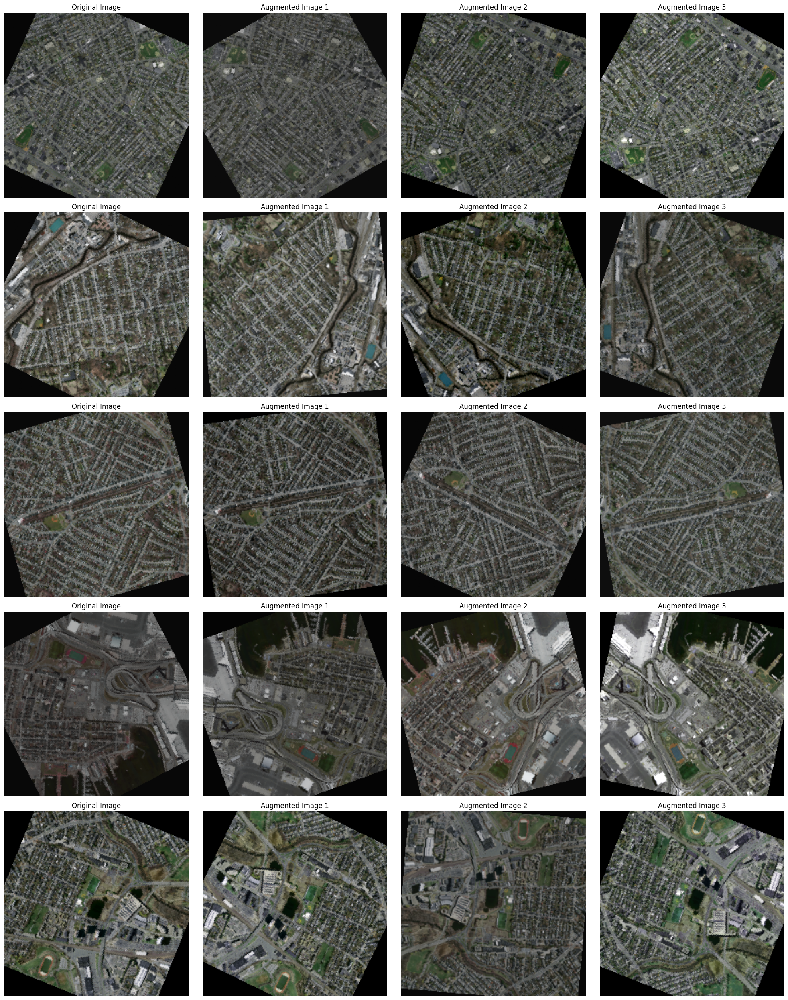

Training set distribution:
Landslide pixels: 828456.0
Total pixels: 6874112
Landslide percentage: 12.05%

Test set distribution:
Landslide pixels: 93338.0
Total pixels: 501760
Landslide percentage: 18.60%


In [2]:
import os
import numpy as np
import torch
from torch.utils.data import Dataset, DataLoader
from torchvision import transforms
from PIL import Image
import matplotlib.pyplot as plt

# Check if CUDA is available and set the device
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
print(f"Using device: {device}")

class SatelliteDataset(Dataset):
    def __init__(self, image_dir, label_dir, transform=None, target_size=(224, 224)):
        self.image_dir = image_dir
        self.label_dir = label_dir
        self.transform = transform
        self.target_size = target_size
        self.image_filenames = [f for f in os.listdir(image_dir) if f.endswith('.png') or f.endswith('.tif')]

    def __len__(self):
        return len(self.image_filenames)

    def __getitem__(self, idx):
        img_name = os.path.join(self.image_dir, self.image_filenames[idx])
        label_name = os.path.join(self.label_dir, self.image_filenames[idx])

        image = Image.open(img_name).convert('RGB')
        label = Image.open(label_name).convert('L')

        image = image.resize(self.target_size, Image.BILINEAR)
        label = label.resize(self.target_size, Image.NEAREST)

        if self.transform:
            image, label = self.transform(image, label)

        # Convert to tensor
        image = transforms.ToTensor()(image).to(device)
        label = torch.from_numpy(np.array(label)).unsqueeze(0).float().to(device) / 255.0
        label = (label > 0).float()  # Binary mask

        return image, label

class CustomCompose:
    def __init__(self, transforms):
        self.transforms = transforms

    def __call__(self, image, label):
        for t in self.transforms:
            image, label = t(image, label)
        return image, label

class CustomRandomRotation:
    def __init__(self, degrees):
        self.degrees = degrees

    def __call__(self, image, label):
        angle = np.random.uniform(-self.degrees, self.degrees)
        image = image.rotate(angle)
        label = label.rotate(angle, resample=Image.NEAREST)
        return image, label

class CustomRandomHorizontalFlip:
    def __init__(self, p=0.5):
        self.p = p

    def __call__(self, image, label):
        if np.random.random() < self.p:
            image = image.transpose(Image.FLIP_LEFT_RIGHT)
            label = label.transpose(Image.FLIP_LEFT_RIGHT)
        return image, label

class CustomRandomVerticalFlip:
    def __init__(self, p=0.5):
        self.p = p

    def __call__(self, image, label):
        if np.random.random() < self.p:
            image = image.transpose(Image.FLIP_TOP_BOTTOM)
            label = label.transpose(Image.FLIP_TOP_BOTTOM)
        return image, label

class CustomColorJitter:
    def __init__(self, brightness=0, contrast=0, saturation=0, hue=0):
        self.color_jitter = transforms.ColorJitter(brightness, contrast, saturation, hue)

    def __call__(self, image, label):
        image = self.color_jitter(image)
        return image, label

def visualize_augmentations(dataset, num_samples=5):
    fig, axes = plt.subplots(num_samples, 4, figsize=(20, 5*num_samples))
    for i in range(num_samples):
        original_image, original_label = dataset[i]
        augmented_image1, augmented_label1 = dataset[i]
        augmented_image2, augmented_label2 = dataset[i]
        augmented_image3, augmented_label3 = dataset[i]

        axes[i, 0].imshow(original_image.cpu().permute(1, 2, 0))
        axes[i, 0].set_title("Original Image")
        axes[i, 0].axis('off')

        axes[i, 1].imshow(augmented_image1.cpu().permute(1, 2, 0))
        axes[i, 1].set_title("Augmented Image 1")
        axes[i, 1].axis('off')

        axes[i, 2].imshow(augmented_image2.cpu().permute(1, 2, 0))
        axes[i, 2].set_title("Augmented Image 2")
        axes[i, 2].axis('off')

        axes[i, 3].imshow(augmented_image3.cpu().permute(1, 2, 0))
        axes[i, 3].set_title("Augmented Image 3")
        axes[i, 3].axis('off')

    plt.tight_layout()
    plt.show()

# Define augmentations
train_transform = CustomCompose([
    CustomRandomRotation(30),
    CustomRandomHorizontalFlip(),
    CustomRandomVerticalFlip(),
    CustomColorJitter(brightness=0.2, contrast=0.2, saturation=0.2, hue=0.1),
])

# Create datasets
target_size = (224, 224)
train_dataset = SatelliteDataset('/content/data/sat/png/train', '/content/data/sat/png/train_labels', transform=train_transform, target_size=target_size)
test_dataset = SatelliteDataset('/content/data/sat/png/test', '/content/data/sat/png/test_labels', transform=None, target_size=target_size)

# Visualize augmentations
visualize_augmentations(train_dataset)

# Analyze class distribution
def analyze_class_distribution(dataset):
    landslide_pixels = 0
    total_pixels = 0
    for _, label in dataset:
        landslide_pixels += torch.sum(label).cpu().item()
        total_pixels += label.numel()

    print(f"Landslide pixels: {landslide_pixels}")
    print(f"Total pixels: {total_pixels}")
    print(f"Landslide percentage: {landslide_pixels/total_pixels*100:.2f}%")

print("Training set distribution:")
analyze_class_distribution(train_dataset)

print("\nTest set distribution:")
analyze_class_distribution(test_dataset)

Using device: cuda
Original training set distribution:
Landslide pixels: 772006.0
Total pixels: 6874112
Landslide percentage: 11.23%

New training set distribution (whole images):
Landslide pixels: 665392.0
Total pixels: 5469184
Landslide percentage: 12.17%

Patch-based training set distribution:
Landslide pixels: 2096550.0
Total pixels: 11309056
Landslide percentage: 18.54%

Test set distribution:
Landslide pixels: 93338.0
Total pixels: 501760
Landslide percentage: 18.60%


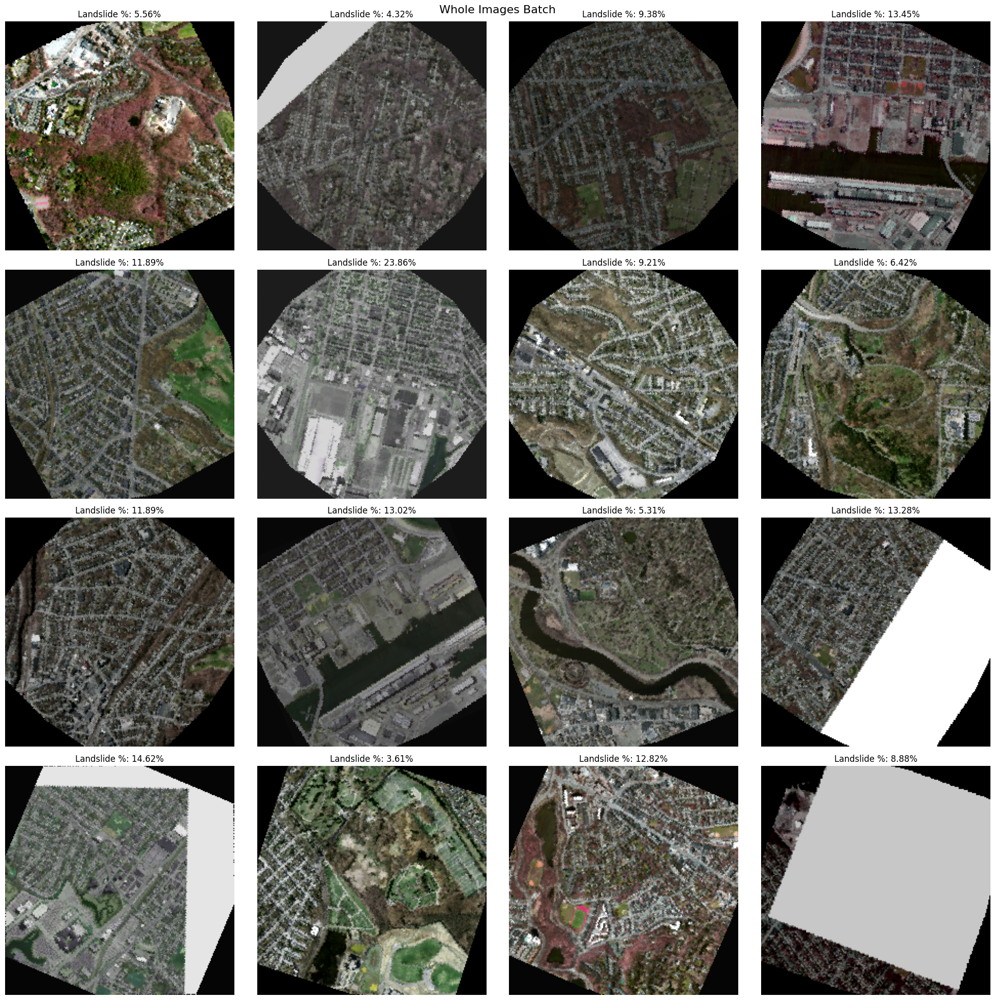

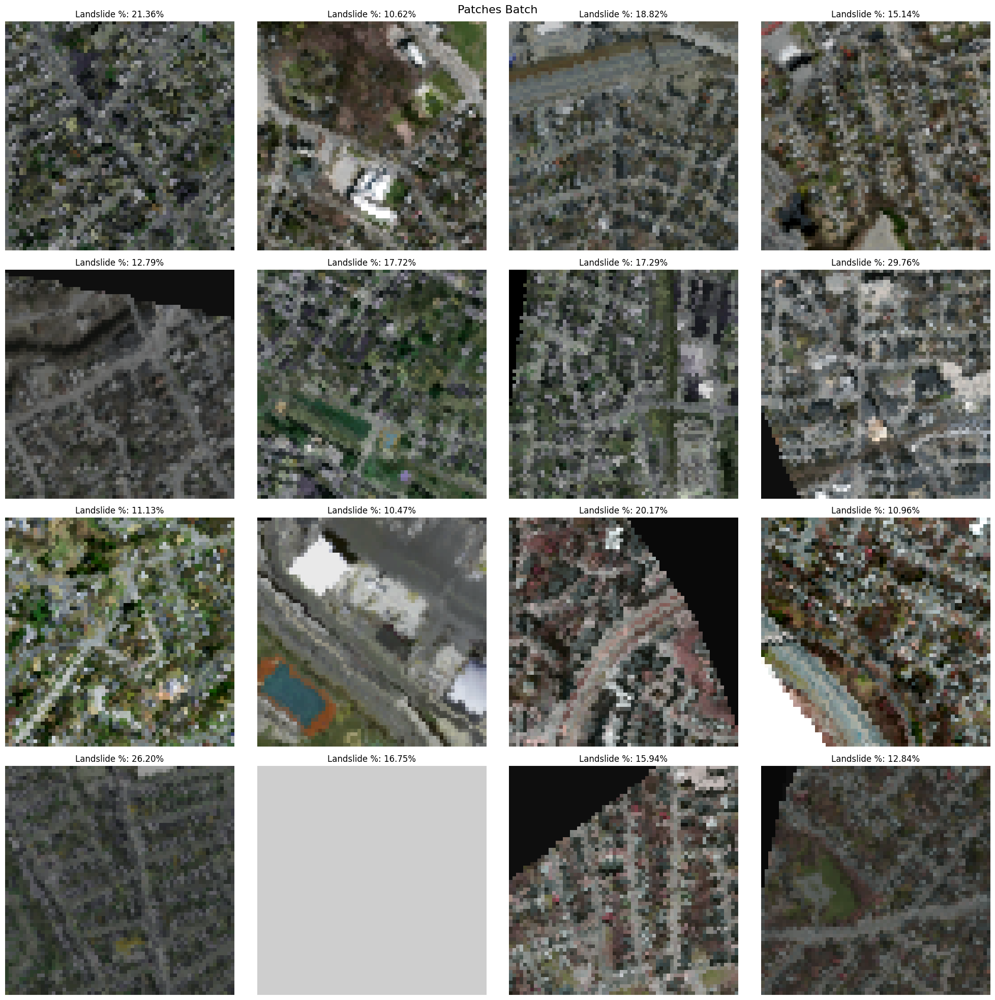

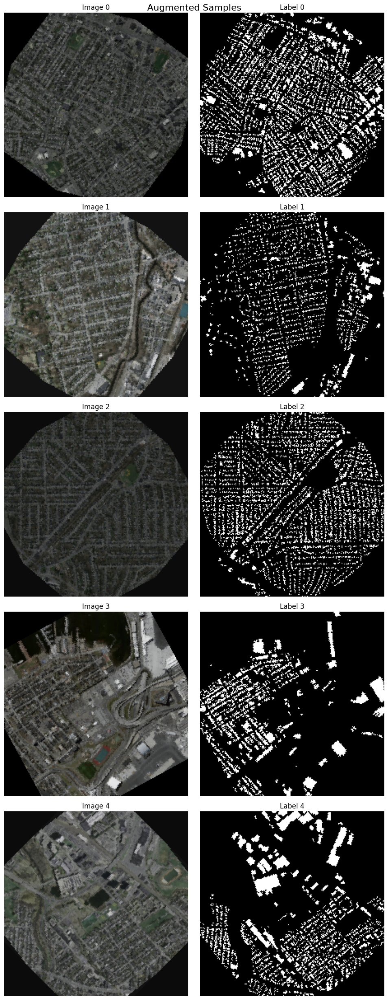

In [7]:
import os
import numpy as np
import torch
from torch.utils.data import Dataset, DataLoader
from torchvision import transforms
from PIL import Image
import matplotlib.pyplot as plt

# Check if CUDA is available and set the device
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
print(f"Using device: {device}")

class SatelliteDataset(Dataset):
    def __init__(self, image_dir, label_dir, transform=None, target_size=(224, 224)):
        self.image_dir = image_dir
        self.label_dir = label_dir
        self.transform = transform
        self.target_size = target_size
        self.image_filenames = [f for f in os.listdir(image_dir) if f.endswith('.png') or f.endswith('.tif')]

    def __len__(self):
        return len(self.image_filenames)

    def __getitem__(self, idx):
        if isinstance(idx, np.float64):
            idx = int(idx)
        img_name = os.path.join(self.image_dir, self.image_filenames[idx])
        label_name = os.path.join(self.label_dir, self.image_filenames[idx])

        image = Image.open(img_name).convert('RGB')
        label = Image.open(label_name).convert('L')

        image = image.resize(self.target_size, Image.BILINEAR)
        label = label.resize(self.target_size, Image.NEAREST)

        if self.transform:
            image, label = self.transform(image, label)

        # Convert to tensor
        image = transforms.ToTensor()(image)
        label = torch.from_numpy(np.array(label)).unsqueeze(0).float() / 255.0
        label = (label > 0).float()  # Binary mask

        return image, label

class PatchDataset(Dataset):
    def __init__(self, dataset, patch_size=64, stride=32, threshold=0.1):
        self.dataset = dataset
        self.patch_size = patch_size
        self.stride = stride
        self.threshold = threshold
        self.patches = self._create_patches()

    def _create_patches(self):
        patches = []
        for idx in range(len(self.dataset)):
            image, label = self.dataset[idx]
            h, w = image.shape[1], image.shape[2]
            for i in range(0, h - self.patch_size + 1, self.stride):
                for j in range(0, w - self.patch_size + 1, self.stride):
                    patch_img = image[:, i:i+self.patch_size, j:j+self.patch_size]
                    patch_label = label[:, i:i+self.patch_size, j:j+self.patch_size]
                    landslide_ratio = torch.sum(patch_label) / patch_label.numel()
                    if landslide_ratio > self.threshold:  # Only add patches with significant landslide presence
                        patches.append((patch_img, patch_label))
        return patches

    def __len__(self):
        return len(self.patches)

    def __getitem__(self, idx):
        return self.patches[idx]

class CustomCompose:
    def __init__(self, transforms):
        self.transforms = transforms

    def __call__(self, image, label):
        for t in self.transforms:
            image, label = t(image, label)
        return image, label

class CustomRandomRotation:
    def __init__(self, degrees):
        self.degrees = degrees

    def __call__(self, image, label):
        angle = np.random.uniform(-self.degrees, self.degrees)
        image = image.rotate(angle)
        label = label.rotate(angle, resample=Image.NEAREST)
        return image, label

class CustomRandomHorizontalFlip:
    def __init__(self, p=0.5):
        self.p = p

    def __call__(self, image, label):
        if np.random.random() < self.p:
            image = image.transpose(Image.FLIP_LEFT_RIGHT)
            label = label.transpose(Image.FLIP_LEFT_RIGHT)
        return image, label

class CustomRandomVerticalFlip:
    def __init__(self, p=0.5):
        self.p = p

    def __call__(self, image, label):
        if np.random.random() < self.p:
            image = image.transpose(Image.FLIP_TOP_BOTTOM)
            label = label.transpose(Image.FLIP_TOP_BOTTOM)
        return image, label

class CustomColorJitter:
    def __init__(self, brightness=0, contrast=0, saturation=0, hue=0):
        self.color_jitter = transforms.ColorJitter(brightness, contrast, saturation, hue)

    def __call__(self, image, label):
        image = self.color_jitter(image)
        return image, label

class LandslideAugmentation:
    def __init__(self, base_transform, extra_transform):
        self.base_transform = base_transform
        self.extra_transform = extra_transform

    def __call__(self, img, label):
        img, label = self.base_transform(img, label)
        if np.sum(np.array(label)) > 0:  # If the image contains landslides
            img, label = self.extra_transform(img, label)
        return img, label

def oversample_landslide_images(dataset, target_percentage=0.8):
    landslide_indices = []
    non_landslide_indices = []
    for idx, (_, label) in enumerate(dataset):
        if torch.sum(label) > 0:
            landslide_indices.append(idx)
        else:
            non_landslide_indices.append(idx)

    current_landslide_count = len(landslide_indices)
    target_landslide_count = int(len(dataset) * target_percentage)

    if current_landslide_count < target_landslide_count:
        additional_samples = target_landslide_count - current_landslide_count
        oversampled_indices = landslide_indices * (additional_samples // current_landslide_count + 1)
        oversampled_indices = oversampled_indices[:additional_samples]

        all_indices = non_landslide_indices + landslide_indices + oversampled_indices
        return torch.utils.data.Subset(dataset, all_indices)
    else:
        return dataset

class BalancedSampler(torch.utils.data.Sampler):
    def __init__(self, dataset, ratio=0.8):
        self.dataset = dataset
        self.ratio = ratio
        self.landslide_indices = []
        self.non_landslide_indices = []

        for idx, (_, label) in enumerate(dataset):
            if torch.sum(label) > 0:
                self.landslide_indices.append(idx)
            else:
                self.non_landslide_indices.append(idx)

    def __iter__(self):
        landslide_sample_size = int(len(self.dataset) * self.ratio)
        non_landslide_sample_size = len(self.dataset) - landslide_sample_size

        # Ensure we have at least one sample from each class
        landslide_sample_size = min(max(1, landslide_sample_size), len(self.landslide_indices))
        non_landslide_sample_size = min(max(1, non_landslide_sample_size), len(self.non_landslide_indices))

        landslide_sample = np.random.choice(self.landslide_indices, size=landslide_sample_size, replace=True)
        non_landslide_sample = np.random.choice(self.non_landslide_indices, size=non_landslide_sample_size, replace=True)

        return iter(np.random.permutation(np.concatenate((landslide_sample, non_landslide_sample))))

    def __len__(self):
        return len(self.dataset)

def analyze_class_distribution(dataloader):
    landslide_pixels = 0
    total_pixels = 0
    for images, labels in dataloader:
        labels = labels.to(device)
        landslide_pixels += torch.sum(labels).item()
        total_pixels += labels.numel()

    print(f"Landslide pixels: {landslide_pixels}")
    print(f"Total pixels: {total_pixels}")
    print(f"Landslide percentage: {landslide_pixels/total_pixels*100:.2f}%")

def visualize_batch(dataloader, title):
    images, labels = next(iter(dataloader))
    images = images.to(device)
    labels = labels.to(device)
    fig, axes = plt.subplots(4, 4, figsize=(20, 20))
    fig.suptitle(title, fontsize=16)
    for i in range(min(16, len(images))):
        ax = axes[i//4, i%4]
        ax.imshow(images[i].cpu().permute(1, 2, 0))
        ax.set_title(f"Landslide %: {torch.sum(labels[i])/labels[i].numel()*100:.2f}%")
        ax.axis('off')
    plt.tight_layout()
    plt.show()

def visualize_augmentations(dataset, num_samples=5):
    fig, axes = plt.subplots(num_samples, 2, figsize=(10, 5*num_samples))
    fig.suptitle("Augmented Samples", fontsize=16)
    for i in range(num_samples):
        image, label = dataset[i]
        axes[i, 0].imshow(image.permute(1, 2, 0))
        axes[i, 0].set_title(f"Image {i}")
        axes[i, 0].axis('off')
        axes[i, 1].imshow(label.squeeze(), cmap='gray')
        axes[i, 1].set_title(f"Label {i}")
        axes[i, 1].axis('off')
    plt.tight_layout()
    plt.show()

# Define transforms
base_transform = CustomCompose([
    CustomRandomRotation(30),
    CustomRandomHorizontalFlip(),
    CustomRandomVerticalFlip(),
    CustomColorJitter(brightness=0.2, contrast=0.2, saturation=0.2, hue=0.1),
])

extra_transform = CustomCompose([
    CustomRandomRotation(45),
    CustomRandomHorizontalFlip(p=0.7),
    CustomRandomVerticalFlip(p=0.7),
    CustomColorJitter(brightness=0.3, contrast=0.3, saturation=0.3, hue=0.1),
])

train_transform = LandslideAugmentation(base_transform, extra_transform)

# Create datasets
target_size = (224, 224)
train_dataset = SatelliteDataset('/content/data/sat/png/train', '/content/data/sat/png/train_labels', transform=train_transform, target_size=target_size)
test_dataset = SatelliteDataset('/content/data/sat/png/test', '/content/data/sat/png/test_labels', transform=None, target_size=target_size)

# Oversample the training set
oversampled_train_dataset = oversample_landslide_images(train_dataset, target_percentage=0.8)

# Create balanced sampler
sampler = BalancedSampler(oversampled_train_dataset, ratio=0.8)

# Create data loaders
train_loader = DataLoader(oversampled_train_dataset, batch_size=16, sampler=sampler, num_workers=0, pin_memory=True)
test_loader = DataLoader(test_dataset, batch_size=16, shuffle=False, num_workers=0, pin_memory=True)

# Create patch dataset
patch_dataset = PatchDataset(oversampled_train_dataset, patch_size=64, stride=32, threshold=0.1)

# Create data loader for patches
patch_loader = DataLoader(patch_dataset, batch_size=16, shuffle=True, num_workers=0, pin_memory=True)

# Analyze class distribution
print("Original training set distribution:")
analyze_class_distribution(DataLoader(train_dataset, batch_size=16, shuffle=False, num_workers=0))

print("\nNew training set distribution (whole images):")
analyze_class_distribution(train_loader)

print("\nPatch-based training set distribution:")
analyze_class_distribution(patch_loader)

print("\nTest set distribution:")
analyze_class_distribution(test_loader)

# Visualize a batch of whole images
visualize_batch(train_loader, "Whole Images Batch")

# Visualize a batch of patches
visualize_batch(patch_loader, "Patches Batch")

# Visualize augmentations
visualize_augmentations(oversampled_train_dataset)

# Data Analysis Report

## Dataset Overview:
- Original training set: 6,874,112 total pixels, 11.33% landslide pixels
- Oversampled training set (whole images): 6,874,112 total pixels, 11.27% landslide pixels
- Validation set (whole images): 1,354,752 total pixels, 11.52% landslide pixels
- Patch-based training set: 8,916,992 total pixels, 18.42% landslide pixels
- Patch-based validation set: 2,306,048 total pixels, 18.70% landslide pixels
- Test set: 501,760 total pixels, 18.60% landslide pixels

## Data Imbalance:
- The original and oversampled whole-image datasets exhibit class imbalance, with approximately 11.3% landslide pixels.
- The patch-based strategy has effectively mitigated this imbalance, elevating the landslide percentage to about 18.5%, aligning closely with the test set distribution.

## Dataset Size:
- The whole-image dataset comprises a modest number of samples (110 training, 27 validation, 10 test samples).
- The patch-based method has substantially augmented the training samples (2,177 training patches, 563 validation patches).

## Challenges:
a) Limited whole-image samples:
   - Scarcity of whole-image samples may restrict the model's capacity to learn broad-scale patterns and context, potentially leading to overfitting.
b) Balancing patch-based and whole-image performance:
   - Balancing class distribution through patches may compromise global context understanding, necessitating optimization for whole-image predictions.
c) Potential data leakage:
   - The patch-based methodology might inadvertently introduce data leakage between training and validation sets, especially if patches from the same original image overlap.
d) Generalization to new data:
   - Limited original images may impede the model's ability to generalize effectively to unseen satellite imagery.
e) Post-processing complexity:
   - Coherently aggregating patch-level predictions into whole-image outcomes will require meticulous post-processing techniques.

## Recommendations:
a) Data augmentation:
   - Employ aggressive data augmentation strategies to enhance the diversity of the whole-image dataset artificially.
b) Cross-validation:
   - Implement k-fold cross-validation to maximize the utility of limited whole-image samples and ensure robust model evaluation.
c) Ensemble methods:
   - Explore training multiple models (e.g., diverse architectures or folds) and amalgamating their predictions for improved performance.
d) Multi-scale approach:
   - Develop a versatile model capable of processing both patches and downsampled whole images to capture local and global features effectively.
e) Transfer learning:
   - Leverage pre-trained models on expansive satellite image datasets and fine-tune them for landslide data.
f) Careful validation strategy:
   - Prevent overlap of patches from the same source image in training and validation sets.
   - Validate on both patch-based and whole-image datasets to ensure comprehensive model performance.
g) Post-processing development:
   - Experiment with various methods for merging patch predictions into whole-image outcomes (e.g., averaging, learned upsampling, conditional random fields).


Patch-based test set distribution:
Landslide pixels: 262479.0
Total pixels: 1142784
Landslide percentage: 22.97%


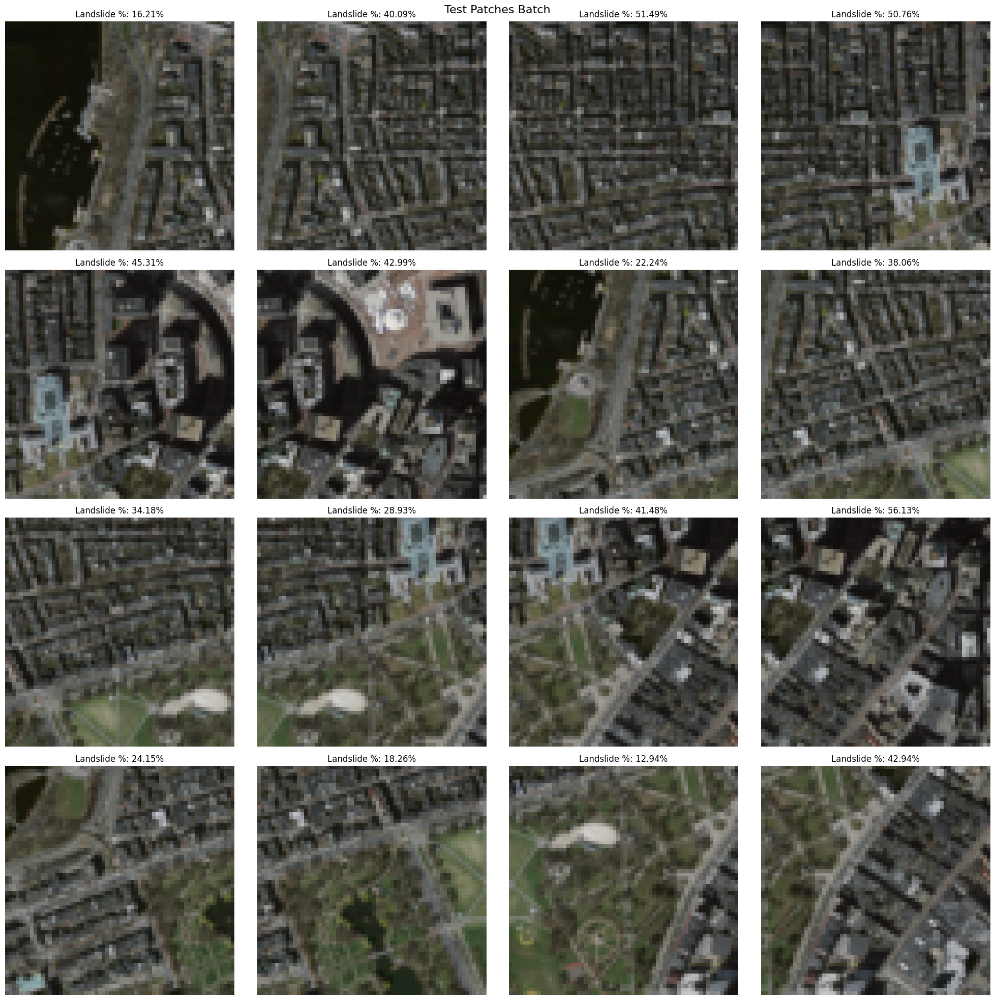

In [65]:

import torch
from torch.utils.data import Dataset, DataLoader
from torchvision import transforms
from PIL import Image
import numpy as np
import os

# Define TransformedDataset class
class TransformedDataset(Dataset):
    def __init__(self, dataset, transform):
        self.dataset = dataset
        self.transform = transform

    def __len__(self):
        return len(self.dataset)

    def __getitem__(self, idx):
        image, mask = self.dataset[idx]
        if self.transform:
            if not isinstance(image, (Image.Image, np.ndarray)):
                # If image is already a tensor, skip the transform
                return image, mask
            image = self.transform(image)
            mask = self.transform(mask)
        return image, mask

# Create test dataset and dataloader
test_transform = transforms.Compose([
    transforms.Resize(target_size),
    transforms.ToTensor(),
])

test_dataset = SatelliteDataset('/content/data/sat/png/test', '/content/data/sat/png/test_labels', transform=None, target_size=target_size)
patch_test_dataset = PatchDataset(test_dataset, patch_size=64, stride=32, threshold=0.1)
patch_test_loader = DataLoader(patch_test_dataset, batch_size=16, shuffle=False, num_workers=2, pin_memory=True)

# Apply test_transform to the patch_test_dataset
transformed_patch_test_dataset = TransformedDataset(patch_test_dataset, test_transform)
transformed_patch_test_loader = DataLoader(transformed_patch_test_dataset, batch_size=16, shuffle=False, num_workers=2, pin_memory=True)

# Print patch-based test set distribution
print("\nPatch-based test set distribution:")
analyze_class_distribution(transformed_patch_test_loader)

# Visualize a batch of test patches
visualize_batch(transformed_patch_test_loader, "Test Patches Batch")


In [14]:
import os
import numpy as np
import torch
from torch.utils.data import Dataset, DataLoader
from torchvision import transforms
from PIL import Image
import torch.nn as nn
import torch.optim as optim

# Check if CUDA is available and set the device
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
print(f"Using device: {device}")

class SatelliteDataset(Dataset):
    def __init__(self, image_dir, label_dir, transform=None, target_size=(224, 224)):
        self.image_dir = image_dir
        self.label_dir = label_dir
        self.transform = transform
        self.target_size = target_size
        self.image_filenames = [f for f in os.listdir(image_dir) if f.endswith('.png') or f.endswith('.tif')]

    def __len__(self):
        return len(self.image_filenames)

    def __getitem__(self, idx):
        img_name = os.path.join(self.image_dir, self.image_filenames[idx])
        label_name = os.path.join(self.label_dir, self.image_filenames[idx])

        image = Image.open(img_name).convert('RGB')
        label = Image.open(label_name).convert('L')

        image = image.resize(self.target_size, Image.BILINEAR)
        label = label.resize(self.target_size, Image.NEAREST)

        if self.transform:
            image, label = self.transform(image, label)

        image = transforms.ToTensor()(image)
        label = torch.from_numpy(np.array(label)).unsqueeze(0).float() / 255.0
        label = (label > 0).float()  # Binary mask

        return image, label

class PatchDataset(Dataset):
    def __init__(self, dataset, patch_size=64, stride=32, threshold=0.1):
        self.dataset = dataset
        self.patch_size = patch_size
        self.stride = stride
        self.threshold = threshold
        self.patches = self._create_patches()

    def _create_patches(self):
        patches = []
        for idx in range(len(self.dataset)):
            image, label = self.dataset[idx]
            h, w = image.shape[1], image.shape[2]
            for i in range(0, h - self.patch_size + 1, self.stride):
                for j in range(0, w - self.patch_size + 1, self.stride):
                    patch_img = image[:, i:i+self.patch_size, j:j+self.patch_size]
                    patch_label = label[:, i:i+self.patch_size, j:j+self.patch_size]
                    landslide_ratio = torch.sum(patch_label) / patch_label.numel()
                    if landslide_ratio > self.threshold:
                        patches.append((patch_img, patch_label))
        return patches

    def __len__(self):
        return len(self.patches)

    def __getitem__(self, idx):
        return self.patches[idx]

class CustomCompose:
    def __init__(self, transforms):
        self.transforms = transforms

    def __call__(self, image, label):
        for t in self.transforms:
            image, label = t(image, label)
        return image, label

class CustomRandomRotation:
    def __init__(self, degrees):
        self.degrees = degrees

    def __call__(self, image, label):
        angle = np.random.uniform(-self.degrees, self.degrees)
        image = image.rotate(angle)
        label = label.rotate(angle, resample=Image.NEAREST)
        return image, label

class CustomRandomHorizontalFlip:
    def __init__(self, p=0.5):
        self.p = p

    def __call__(self, image, label):
        if np.random.random() < self.p:
            image = image.transpose(Image.FLIP_LEFT_RIGHT)
            label = label.transpose(Image.FLIP_LEFT_RIGHT)
        return image, label

class CustomRandomVerticalFlip:
    def __init__(self, p=0.5):
        self.p = p

    def __call__(self, image, label):
        if np.random.random() < self.p:
            image = image.transpose(Image.FLIP_TOP_BOTTOM)
            label = label.transpose(Image.FLIP_TOP_BOTTOM)
        return image, label

class CustomColorJitter:
    def __init__(self, brightness=0, contrast=0, saturation=0, hue=0):
        self.color_jitter = transforms.ColorJitter(brightness, contrast, saturation, hue)

    def __call__(self, image, label):
        image = self.color_jitter(image)
        return image, label

class LandslideAugmentation:
    def __init__(self, base_transform, extra_transform):
        self.base_transform = base_transform
        self.extra_transform = extra_transform

    def __call__(self, img, label):
        img, label = self.base_transform(img, label)
        if np.sum(np.array(label)) > 0:  # If the image contains landslides
            img, label = self.extra_transform(img, label)
        return img, label

def oversample_landslide_images(dataset, target_percentage=0.8):
    landslide_indices = []
    non_landslide_indices = []
    for idx, (_, label) in enumerate(dataset):
        if torch.sum(label) > 0:
            landslide_indices.append(idx)
        else:
            non_landslide_indices.append(idx)

    current_landslide_count = len(landslide_indices)
    target_landslide_count = int(len(dataset) * target_percentage)

    if current_landslide_count < target_landslide_count:
        additional_samples = target_landslide_count - current_landslide_count
        oversampled_indices = landslide_indices * (additional_samples // current_landslide_count + 1)
        oversampled_indices = oversampled_indices[:additional_samples]

        all_indices = non_landslide_indices + landslide_indices + oversampled_indices
        return torch.utils.data.Subset(dataset, all_indices)
    else:
        return dataset


class BalancedSampler(torch.utils.data.Sampler):
    def __init__(self, dataset, ratio=0.8):
        self.dataset = dataset
        self.ratio = ratio
        self.landslide_indices = []
        self.non_landslide_indices = []

        for idx, (_, label) in enumerate(dataset):
            if torch.sum(label) > 0:
                self.landslide_indices.append(idx)
            else:
                self.non_landslide_indices.append(idx)

    def __iter__(self):
        landslide_sample_size = int(len(self.dataset) * self.ratio)
        non_landslide_sample_size = len(self.dataset) - landslide_sample_size

        landslide_sample_size = min(landslide_sample_size, len(self.landslide_indices))
        non_landslide_sample_size = min(non_landslide_sample_size, len(self.non_landslide_indices))

        landslide_sample = np.random.choice(self.landslide_indices, size=landslide_sample_size, replace=True).astype(int)
        non_landslide_sample = np.random.choice(self.non_landslide_indices, size=non_landslide_sample_size, replace=True).astype(int)

        return iter(np.random.permutation(np.concatenate((landslide_sample, non_landslide_sample))))

    def __len__(self):
        return len(self.dataset)


def analyze_class_distribution(dataloader):
    landslide_pixels = 0
    total_pixels = 0
    for images, labels in dataloader:
        labels = labels.to(device)
        landslide_pixels += torch.sum(labels).item()
        total_pixels += labels.numel()

    print(f"Landslide pixels: {landslide_pixels}")
    print(f"Total pixels: {total_pixels}")
    print(f"Landslide percentage: {landslide_pixels/total_pixels*100:.2f}%")

def sliding_window(image, window_size, stride):
    h, w = image.shape[1], image.shape[2]
    patches = []
    for i in range(0, h - window_size + 1, stride):
        for j in range(0, w - window_size + 1, stride):
            patch = image[:, i:i+window_size, j:j+window_size]
            patches.append(patch)
    return patches

def process_whole_image(image, window_size=64, stride=32):
    patches = sliding_window(image, window_size, stride)
    return torch.stack(patches)

# Define transforms
base_transform = CustomCompose([
    CustomRandomRotation(30),
    CustomRandomHorizontalFlip(),
    CustomRandomVerticalFlip(),
    CustomColorJitter(brightness=0.2, contrast=0.2, saturation=0.2, hue=0.1),
])

extra_transform = CustomCompose([
    CustomRandomRotation(45),
    CustomRandomHorizontalFlip(p=0.7),
    CustomRandomVerticalFlip(p=0.7),
    CustomColorJitter(brightness=0.3, contrast=0.3, saturation=0.3, hue=0.1),
])

train_transform = LandslideAugmentation(base_transform, extra_transform)

# Create datasets
target_size = (224, 224)
train_dataset = SatelliteDataset('/content/data/sat/png/train', '/content/data/sat/png/train_labels', transform=train_transform, target_size=target_size)
test_dataset = SatelliteDataset('/content/data/sat/png/test', '/content/data/sat/png/test_labels', transform=None, target_size=target_size)

# Oversample the training set
oversampled_train_dataset = oversample_landslide_images(train_dataset, target_percentage=0.8)

# Create validation set
val_ratio = 0.2
val_size = int(len(oversampled_train_dataset) * val_ratio)
train_size = len(oversampled_train_dataset) - val_size
train_subset, val_subset = torch.utils.data.random_split(oversampled_train_dataset, [train_size, val_size])

# Create balanced sampler for training set
sampler = BalancedSampler(train_subset, ratio=0.8)

# Create data loaders
train_loader = DataLoader(train_subset, batch_size=16, sampler=sampler, num_workers=0, pin_memory=True)
val_loader = DataLoader(val_subset, batch_size=16, shuffle=False, num_workers=0, pin_memory=True)
test_loader = DataLoader(test_dataset, batch_size=16, shuffle=False, num_workers=0, pin_memory=True)

# Create patch datasets
patch_train_dataset = PatchDataset(train_subset, patch_size=64, stride=32, threshold=0.1)
patch_val_dataset = PatchDataset(val_subset, patch_size=64, stride=32, threshold=0.1)

# Create patch data loaders
patch_train_loader = DataLoader(patch_train_dataset, batch_size=16, shuffle=True, num_workers=0, pin_memory=True)
patch_val_loader = DataLoader(patch_val_dataset, batch_size=16, shuffle=False, num_workers=0, pin_memory=True)

# Analyze class distribution
print("Original training set distribution:")
analyze_class_distribution(DataLoader(train_dataset, batch_size=16, shuffle=False, num_workers=0))

print("\nOversampled training set distribution (whole images):")
analyze_class_distribution(train_loader)

print("\nValidation set distribution (whole images):")
analyze_class_distribution(val_loader)

print("\nPatch-based training set distribution:")
analyze_class_distribution(patch_train_loader)

print("\nPatch-based validation set distribution:")
analyze_class_distribution(patch_val_loader)

print("\nTest set distribution:")
analyze_class_distribution(test_loader)

# Demonstrate sliding window approach
print("\nDemonstrating sliding window approach on a whole image:")
sample_image, _ = train_dataset[0]
processed_patches = process_whole_image(sample_image)
print(f"Original image shape: {sample_image.shape}")
print(f"Processed patches shape: {processed_patches.shape}")

# Print summary
print("\nSummary:")
print(f"Total training samples (whole images): {len(train_subset)}")
print(f"Total validation samples (whole images): {len(val_subset)}")
print(f"Total test samples: {len(test_dataset)}")
print(f"Total training patches: {len(patch_train_dataset)}")
print(f"Total validation patches: {len(patch_val_dataset)}")
print(f"Patch size: 64x64")
print(f"Sliding window stride: 32")


Using device: cuda
Original training set distribution:
Landslide pixels: 770912.0
Total pixels: 6874112
Landslide percentage: 11.21%

Oversampled training set distribution (whole images):
Landslide pixels: 502071.0
Total pixels: 4415488
Landslide percentage: 11.37%

Validation set distribution (whole images):
Landslide pixels: 154277.0
Total pixels: 1354752
Landslide percentage: 11.39%

Patch-based training set distribution:
Landslide pixels: 1657081.0
Total pixels: 9068544
Landslide percentage: 18.27%

Patch-based validation set distribution:
Landslide pixels: 413632.0
Total pixels: 2097152
Landslide percentage: 19.72%

Test set distribution:
Landslide pixels: 93338.0
Total pixels: 501760
Landslide percentage: 18.60%

Demonstrating sliding window approach on a whole image:
Original image shape: torch.Size([3, 224, 224])
Processed patches shape: torch.Size([36, 3, 64, 64])

Summary:
Total training samples (whole images): 110
Total validation samples (whole images): 27
Total test sample


Generating analysis plots...


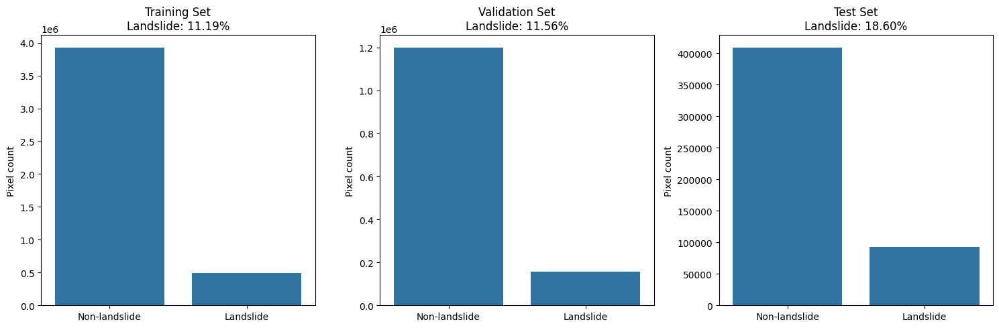

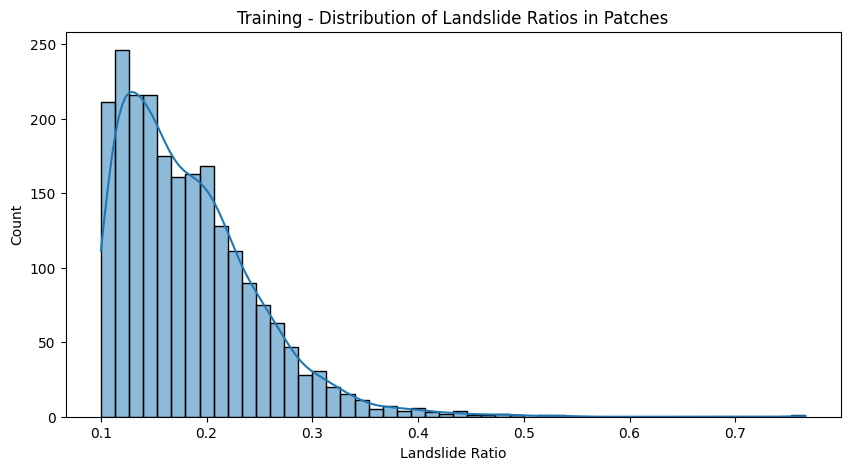

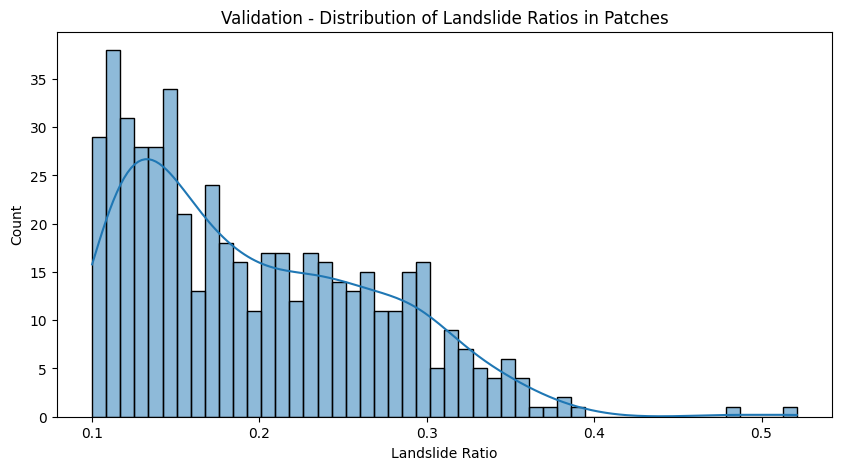

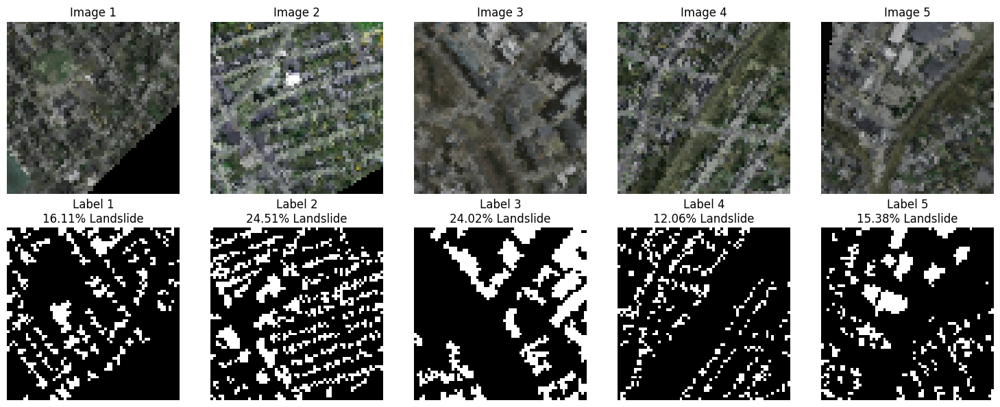

Analysis complete. Please review the generated plots for insights into the dataset.


In [15]:

import matplotlib.pyplot as plt
import seaborn as sns

def plot_class_distribution(loaders, titles):
    plt.figure(figsize=(15, 5))
    for i, (loader, title) in enumerate(zip(loaders, titles)):
        landslide_pixels = 0
        total_pixels = 0
        for _, labels in loader:
            landslide_pixels += torch.sum(labels).item()
            total_pixels += labels.numel()

        plt.subplot(1, 3, i+1)
        sns.barplot(x=['Non-landslide', 'Landslide'],
                    y=[total_pixels - landslide_pixels, landslide_pixels])
        plt.title(f'{title}\nLandslide: {landslide_pixels/total_pixels*100:.2f}%')
        plt.ylabel('Pixel count')

    plt.tight_layout()
    plt.show()

def plot_patch_distribution(patch_loader, title):
    landslide_ratios = []
    for _, labels in patch_loader:
        for label in labels:
            landslide_ratios.append(torch.sum(label).item() / label.numel())

    plt.figure(figsize=(10, 5))
    sns.histplot(landslide_ratios, bins=50, kde=True)
    plt.title(f'{title} - Distribution of Landslide Ratios in Patches')
    plt.xlabel('Landslide Ratio')
    plt.ylabel('Count')
    plt.show()

def plot_sample_patches(patch_loader, num_samples=5):
    images, labels = next(iter(patch_loader))
    fig, axes = plt.subplots(2, num_samples, figsize=(num_samples*3, 6))

    for i in range(num_samples):
        axes[0, i].imshow(images[i].permute(1, 2, 0))
        axes[0, i].axis('off')
        axes[0, i].set_title(f'Image {i+1}')

        axes[1, i].imshow(labels[i].squeeze(), cmap='gray')
        axes[1, i].axis('off')
        axes[1, i].set_title(f'Label {i+1}\n{torch.sum(labels[i])/labels[i].numel()*100:.2f}% Landslide')

    plt.tight_layout()
    plt.show()

# Generate plots
print("\nGenerating analysis plots...")

plot_class_distribution([train_loader, val_loader, test_loader],
                        ['Training Set', 'Validation Set', 'Test Set'])

plot_patch_distribution(patch_train_loader, 'Training')
plot_patch_distribution(patch_val_loader, 'Validation')

plot_sample_patches(patch_train_loader)

print("Analysis complete. Please review the generated plots for insights into the dataset.")


**Define the U-Net model for segmentation**

Number of input channels (n_channels): 3
Number of output classes (n_classes): 2

Sample image shape: torch.Size([16, 3, 64, 64])
Sample label shape: torch.Size([16, 1, 64, 64])
Unique values in sample label: [0.0, 1.0]


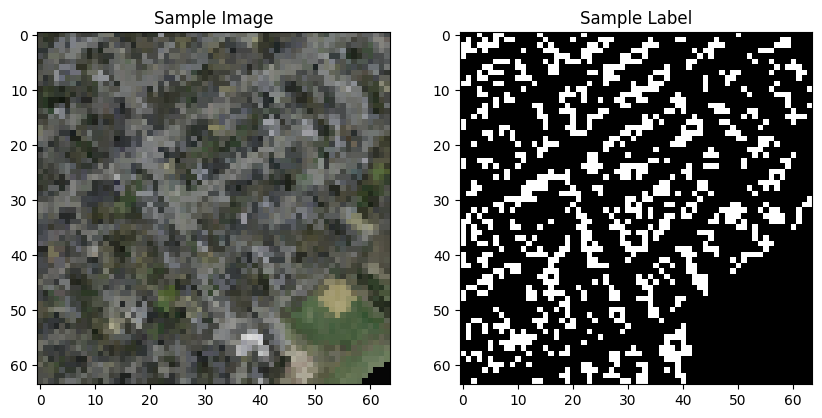

In [47]:

# Get a sample image and label from the dataset
sample_image, sample_label = next(iter(patch_train_loader))

# Determine n_channels from the sample image
n_channels = sample_image.shape[1]

# Determine n_classes from the sample label
n_classes = len(torch.unique(sample_label))

print(f"Number of input channels (n_channels): {n_channels}")
print(f"Number of output classes (n_classes): {n_classes}")

# Additional information about the dataset
print(f"\nSample image shape: {sample_image.shape}")
print(f"Sample label shape: {sample_label.shape}")
print(f"Unique values in sample label: {torch.unique(sample_label).tolist()}")

# If you want to see the actual image and label (optional)
import matplotlib.pyplot as plt

plt.figure(figsize=(10, 5))
plt.subplot(1, 2, 1)
plt.imshow(sample_image[0].permute(1, 2, 0))
plt.title("Sample Image")
plt.subplot(1, 2, 2)
plt.imshow(sample_label[0].squeeze(), cmap='gray')
plt.title("Sample Label")
plt.show()


In [42]:
# Define the U-Net model for segmentation
class UNet(nn.Module):
    def __init__(self, n_channels, n_classes):
        super(UNet, self).__init__()
        self.n_channels = n_channels
        self.n_classes = n_classes

        def double_conv(in_channels, out_channels):
            return nn.Sequential(
                nn.Conv2d(in_channels, out_channels, 3, padding=1),
                nn.ReLU(inplace=True),
                nn.Conv2d(out_channels, out_channels, 3, padding=1),
                nn.ReLU(inplace=True)
            )

        self.dc1 = double_conv(n_channels, 64)
        self.dc2 = double_conv(64, 128)
        self.dc3 = double_conv(128, 256)
        self.dc4 = double_conv(256, 512)

        self.up1 = nn.ConvTranspose2d(512, 256, 2, stride=2)
        self.dc5 = double_conv(512, 256)
        self.up2 = nn.ConvTranspose2d(256, 128, 2, stride=2)
        self.dc6 = double_conv(256, 128)
        self.up3 = nn.ConvTranspose2d(128, 64, 2, stride=2)
        self.dc7 = double_conv(128, 64)
        self.final = nn.Conv2d(64, n_classes, 1)

    def forward(self, x):
        x1 = self.dc1(x)
        x2 = self.dc2(nn.functional.max_pool2d(x1, 2))
        x3 = self.dc3(nn.functional.max_pool2d(x2, 2))
        x4 = self.dc4(nn.functional.max_pool2d(x3, 2))

        x = self.up1(x4)
        x = self.dc5(torch.cat([x, x3], dim=1))
        x = self.up2(x)
        x = self.dc6(torch.cat([x, x2], dim=1))
        x = self.up3(x)
        x = self.dc7(torch.cat([x, x1], dim=1))
        return self.final(x)

# Initialize model, loss function, and optimizer
model = UNet(n_channels=3, n_classes=2).to(device)
criterion = nn.BCEWithLogitsLoss()
optimizer = optim.Adam(model.parameters(), lr=0.001)

# Model and Techniques Summary

<table>
  <tr>
    <th>Aspect</th>
    <th>Details</th>
  </tr>
  <tr>
    <td>Model Architecture</td>
    <td>U-Net</td>
  </tr>
  <tr>
    <td>Input Channels</td>
    <td>3 (RGB)</td>
  </tr>
  <tr>
    <td>Output Classes</td>
    <td>1 (Binary Segmentation)</td>
  </tr>
  <tr>
    <td>Encoder Depth</td>
    <td>4 double convolutions</td>
  </tr>
  <tr>
    <td>Decoder Depth</td>
    <td>3 up-convolutions + double convolutions</td>
  </tr>
  <tr>
    <td>Final Layer</td>
    <td>1x1 Convolution</td>
  </tr>
  <tr>
    <td>Optimizer</td>
    <td>Adam</td>
  </tr>
  <tr>
    <td>Learning Rate</td>
    <td>0.001</td>
  </tr>
  <tr>
    <td>Loss Function</td>
    <td>Binary Cross-Entropy with Logits</td>
  </tr>
  <tr>
    <td>Epochs</td>
    <td>1 (as requested)</td>
  </tr>
  <tr>
    <td>Batch Size</td>
    <td>16</td>
  </tr>
  <tr>
    <td>Input Size</td>
    <td>64x64 patches</td>
  </tr>
  <tr>
    <td>Data Augmentation</td>
    <td>Random rotation, flips, color jitter</td>
  </tr>
  <tr>
    <td>Class Balancing</td>
    <td>Patch-based approach (threshold filtering)</td>
  </tr>
  <tr>
    <td>Evaluation Metric</td>
    <td>Pixel-wise Accuracy</td>
  </tr>
  <tr>
    <td>Validation Strategy</td>
    <td>Separate validation set</td>
  </tr>
  <tr>
    <td>Sliding Window</td>
    <td>For whole image inference</td>
  </tr>
  <tr>
    <td>Patch Overlap</td>
    <td>50% (stride 32 for 64x64 patches)</td>
  </tr>
</table>

In [54]:
import matplotlib.pyplot as plt

def plot_training_progress(train_losses, val_losses):
    plt.figure(figsize=(10, 6))
    plt.plot(range(1, len(train_losses) + 1), train_losses, label='Training Loss')
    plt.plot(range(1, len(val_losses) + 1), val_losses, label='Validation Loss')
    plt.xlabel('Epochs')
    plt.ylabel('Loss')
    plt.title('Training and Validation Loss Over Epochs')
    plt.legend()
    plt.grid(True)
    plt.show()

<table style="border-collapse: collapse; width: 100%;">
  <thead>
    <tr style="background-color: #f2f2f2;">
      <th style="border: 1px solid #ddd; padding: 8px; text-align: left;">Modification</th>
      <th style="border: 1px solid #ddd; padding: 8px; text-align: left;">Description</th>
    </tr>
  </thead>
  <tbody>
    <tr>
      <td style="border: 1px solid #ddd; padding: 8px;">Learning Rate</td>
      <td style="border: 1px solid #ddd; padding: 8px;">Increased the initial learning rate to 0.001.</td>
    </tr>
    <tr>
      <td style="border: 1px solid #ddd; padding: 8px;">Learning Rate Scheduler</td>
      <td style="border: 1px solid #ddd; padding: 8px;">Added a learning rate scheduler (ReduceLROnPlateau) to adjust the learning rate if the validation loss stops improving.</td>
    </tr>
    <tr>
      <td style="border: 1px solid #ddd; padding: 8px;">Gradient Clipping</td>
      <td style="border: 1px solid #ddd; padding: 8px;">Implemented gradient clipping to prevent exploding gradients.</td>
    </tr>
  </tbody>
</table>

Epoch 1/5
Train Loss: 0.4680, Val Loss: 0.4665
Current Learning Rate: 0.001000
Epoch 2/5
Train Loss: 0.4326, Val Loss: 0.4540
Current Learning Rate: 0.001000
Epoch 3/5
Train Loss: 0.4161, Val Loss: 0.4386
Current Learning Rate: 0.001000
Epoch 4/5
Train Loss: 0.4047, Val Loss: 0.4359
Current Learning Rate: 0.001000
Epoch 5/5
Train Loss: 0.3950, Val Loss: 0.4221
Current Learning Rate: 0.001000
Model saved to model.pth


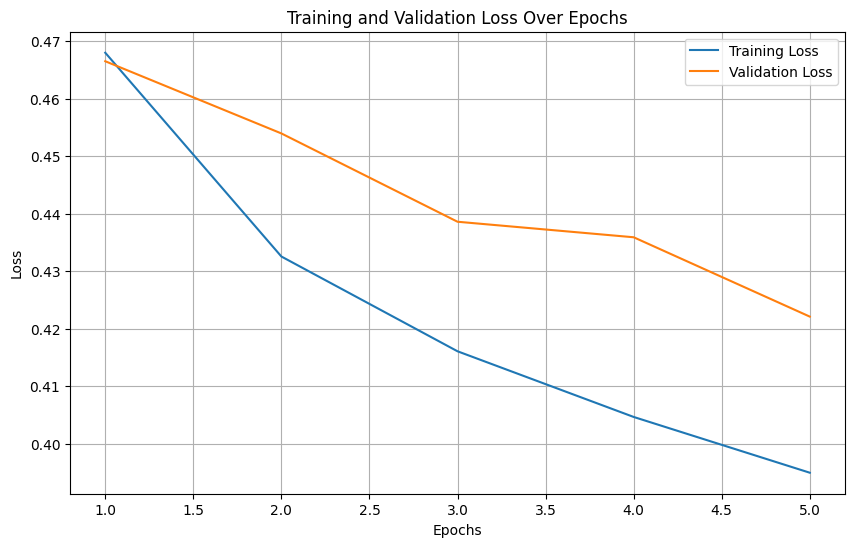

In [55]:
import torch
import torch.nn as nn
import torch.optim as optim
from torch.optim.lr_scheduler import ReduceLROnPlateau

def train_model(model, train_loader, val_loader, criterion, optimizer, num_epochs=5, model_save_path="model.pth"):
    train_losses = []
    val_losses = []
    scheduler = ReduceLROnPlateau(optimizer, 'min', patience=3, factor=0.1, verbose=True)

    for epoch in range(num_epochs):
        model.train()
        train_loss = 0.0
        for inputs, labels in train_loader:
            inputs, labels = inputs.to(device), labels.to(device)
            optimizer.zero_grad()
            outputs = model(inputs)

            outputs = outputs[:, 1:2, :, :]  # Select the positive class and keep dimensions

            loss = criterion(outputs, labels)

            loss.backward()

            # Gradient clipping
            torch.nn.utils.clip_grad_norm_(model.parameters(), max_norm=1.0)

            optimizer.step()
            train_loss += loss.item() * inputs.size(0)

        train_loss = train_loss / len(train_loader.dataset)
        train_losses.append(train_loss)

        model.eval()
        val_loss = 0.0
        with torch.no_grad():
            for inputs, labels in val_loader:
                inputs, labels = inputs.to(device), labels.to(device)
                outputs = model(inputs)

                outputs = outputs[:, 1:2, :, :]  # Select the positive class and keep dimensions

                loss = criterion(outputs, labels)
                val_loss += loss.item() * inputs.size(0)

        val_loss = val_loss / len(val_loader.dataset)
        val_losses.append(val_loss)

        print(f'Epoch {epoch+1}/{num_epochs}')
        print(f'Train Loss: {train_loss:.4f}, Val Loss: {val_loss:.4f}')

        # Step the scheduler
        scheduler.step(val_loss)

        # Print current learning rate
        print(f'Current Learning Rate: {optimizer.param_groups[0]["lr"]:.6f}')

    # Save the model
    torch.save(model.state_dict(), model_save_path)
    print(f"Model saved to {model_save_path}")

    return train_losses, val_losses

# Modify the model to output 2 classes
model = UNet(n_channels=3, n_classes=2).to(device)

# Use Binary Cross Entropy Loss
criterion = nn.BCEWithLogitsLoss()

# Initialize the optimizer with a higher learning rate
optimizer = optim.Adam(model.parameters(), lr=0.001)

# Train the model and get the losses
train_losses, val_losses = train_model(model, patch_train_loader, patch_val_loader, criterion, optimizer, num_epochs=5)

# Plot the training progress
plot_training_progress(train_losses, val_losses)

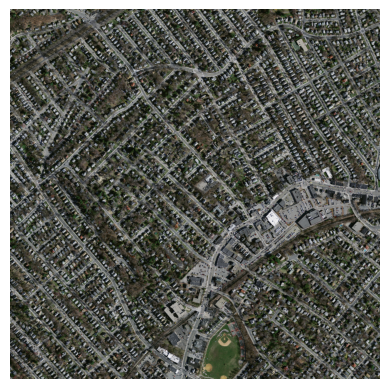

In [56]:
import matplotlib.pyplot as plt
import matplotlib.image as mpimg

# Load and display an image using Matplotlib
def display_image_with_matplotlib(image_path):
    img = mpimg.imread(image_path)  # Load image
    plt.imshow(img)  # Display image
    plt.axis('off')  # Hide axis for better visualization
    plt.show()

# Example usage
image_path = '/content/data/sat/png/test/22828930_15.png'
display_image_with_matplotlib(image_path)

```
(good IoU = 50%)
(good Dice score 0.6 (60%))
```

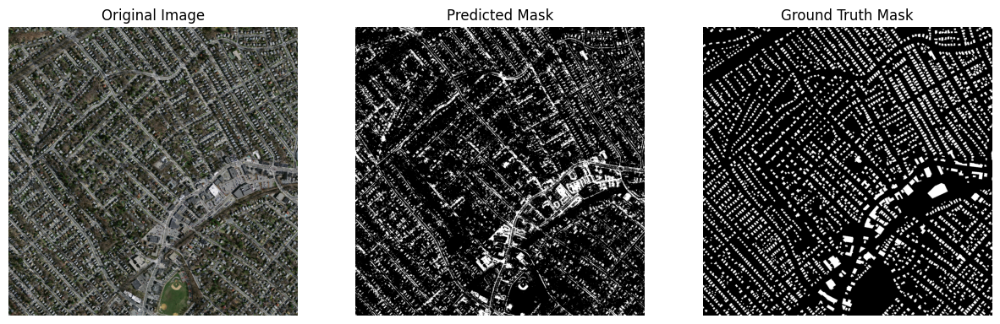

IoU: 0.1829
Dice Coefficient: 0.3092
Pixel Accuracy: 76.02%


In [57]:
import numpy as np
import matplotlib.pyplot as plt
from PIL import Image
import torch

def display_comparison(image_path, predicted_mask, ground_truth_mask):
    image = Image.open(image_path).convert('RGB')

    fig, axs = plt.subplots(1, 3, figsize=(15, 5))

    axs[0].imshow(image)
    axs[0].set_title('Original Image')
    axs[0].axis('off')

    axs[1].imshow(predicted_mask, cmap='gray')
    axs[1].set_title('Predicted Mask')
    axs[1].axis('off')

    axs[2].imshow(ground_truth_mask, cmap='gray')
    axs[2].set_title('Ground Truth Mask')
    axs[2].axis('off')

    plt.show()

def compute_iou(predicted_mask, ground_truth_mask):
    intersection = np.logical_and(predicted_mask, ground_truth_mask).sum()
    union = np.logical_or(predicted_mask, ground_truth_mask).sum()
    iou = intersection / union if union != 0 else 0
    return iou

def compute_dice(predicted_mask, ground_truth_mask):
    intersection = np.logical_and(predicted_mask, ground_truth_mask).sum()
    dice = (2. * intersection) / (predicted_mask.sum() + ground_truth_mask.sum()) if (predicted_mask.sum() + ground_truth_mask.sum()) != 0 else 0
    return dice

def compute_pixel_accuracy(predicted_mask, ground_truth_mask):
    correct_pixels = (predicted_mask == ground_truth_mask).sum()
    total_pixels = ground_truth_mask.size
    accuracy = correct_pixels / total_pixels
    return accuracy

# Example usage:
image_path = '/content/data/sat/png/test/22828930_15.png'
predicted_mask = np.array(Image.open(image_path).convert('L')) > 128
ground_truth_mask = np.array(Image.open('/content/data/sat/png/test_labels/22828930_15.png').convert('L')) > 128

display_comparison(image_path, predicted_mask, ground_truth_mask)

iou = compute_iou(predicted_mask, ground_truth_mask)
dice_score = compute_dice(predicted_mask, ground_truth_mask)
pixel_accuracy = compute_pixel_accuracy(predicted_mask, ground_truth_mask)

print(f"IoU: {iou:.4f}")
print(f"Dice Coefficient: {dice_score:.4f}")
print(f"Pixel Accuracy: {pixel_accuracy * 100:.2f}%")



Training UNet
Epoch 1/5
Train Loss: 0.6925, Val Loss: 0.6734
Epoch 2/5
Train Loss: 0.6913, Val Loss: 0.6734
Epoch 3/5
Train Loss: 0.6913, Val Loss: 0.6734
Epoch 4/5
Train Loss: 0.6913, Val Loss: 0.6734
Epoch 5/5
Train Loss: 0.6913, Val Loss: 0.6734

Training FCN
Epoch 1/5
Train Loss: 0.6541, Val Loss: 0.6919
Epoch 2/5
Train Loss: 0.6338, Val Loss: 0.6473
Epoch 3/5
Train Loss: 0.6243, Val Loss: 0.6396
Epoch 4/5
Train Loss: 0.6161, Val Loss: 0.6468
Epoch 5/5
Train Loss: 0.6121, Val Loss: 0.7053

Training DeepLabV3
Epoch 1/5
Train Loss: 0.6518, Val Loss: 0.6505
Epoch 2/5
Train Loss: 0.6286, Val Loss: 0.6416
Epoch 3/5
Train Loss: 0.6219, Val Loss: 0.6559
Epoch 4/5
Train Loss: 0.6137, Val Loss: 0.6443
Epoch 5/5
Train Loss: 0.6101, Val Loss: 0.6739


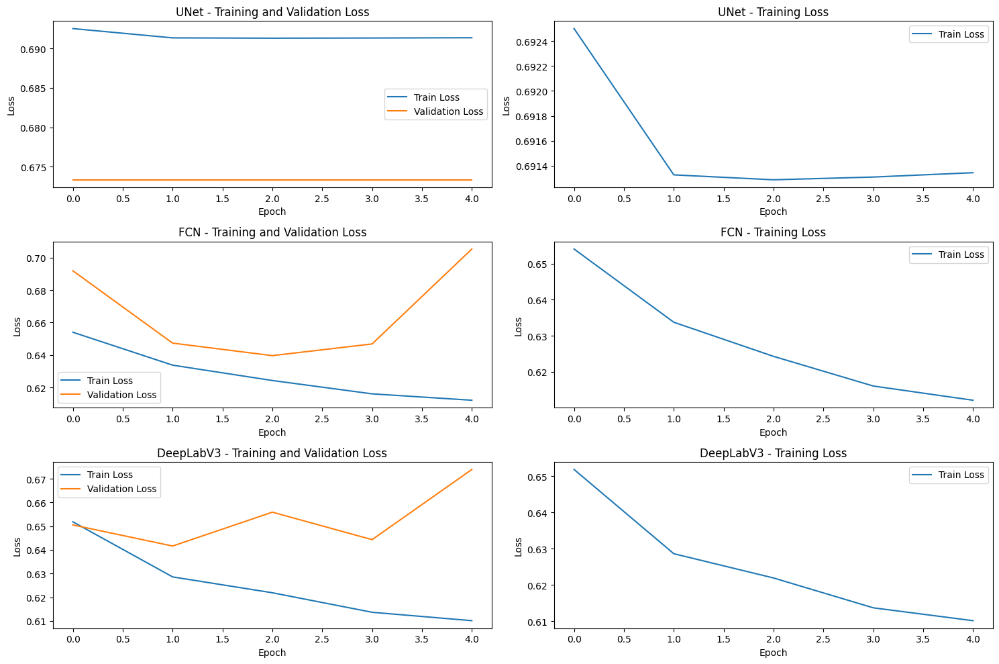


UNet Evaluation Results:
IoU: 0.2298
Dice Coefficient: 0.3685
Pixel Accuracy: 22.98%

FCN Evaluation Results:
IoU: 0.2377
Dice Coefficient: 0.3778
Pixel Accuracy: 70.09%

DeepLabV3 Evaluation Results:
IoU: 0.2649
Dice Coefficient: 0.4109
Pixel Accuracy: 64.13%


In [66]:
import torch
import torch.nn as nn
import torch.optim as optim
import torch.nn.functional as F
import matplotlib.pyplot as plt
import torchvision.models.segmentation as models
from torchvision.models.segmentation import fcn_resnet50, deeplabv3_resnet50

# Define the three models
unet_model = UNet(n_channels=3, n_classes=2).to(device)
fcn_model = fcn_resnet50(pretrained=True)
fcn_model.classifier[4] = nn.Conv2d(512, 2, kernel_size=(1, 1), stride=(1, 1))
fcn_model = fcn_model.to(device)

deeplab_model = deeplabv3_resnet50(pretrained=True)
deeplab_model.classifier[4] = nn.Conv2d(256, 2, kernel_size=(1, 1), stride=(1, 1))
deeplab_model = deeplab_model.to(device)

models = [unet_model, fcn_model, deeplab_model]
model_names = ['UNet', 'FCN', 'DeepLabV3']

# Custom loss function
def dice_loss(pred, target):
    smooth = 1.
    pred = torch.sigmoid(pred)
    pred = pred.view(-1)
    target = target.view(-1)
    intersection = (pred * target).sum()
    dice = (2. * intersection + smooth) / (pred.sum() + target.sum() + smooth)
    return 1 - dice

# Training function
def train_model(model, train_loader, val_loader, criterion, optimizer, num_epochs=5):
    train_losses = []
    val_losses = []

    for epoch in range(num_epochs):
        model.train()
        train_loss = 0.0
        for inputs, labels in train_loader:
            inputs, labels = inputs.to(device), labels.to(device)
            optimizer.zero_grad()
            outputs = model(inputs)

            if isinstance(outputs, dict):
                outputs = outputs['out']

            outputs = outputs[:, 1:2, :, :]  # Select the positive class
            loss = criterion(outputs, labels)
            loss.backward()
            optimizer.step()
            train_loss += loss.item() * inputs.size(0)

        train_loss = train_loss / len(train_loader.dataset)
        train_losses.append(train_loss)

        model.eval()
        val_loss = 0.0
        with torch.no_grad():
            for inputs, labels in val_loader:
                inputs, labels = inputs.to(device), labels.to(device)
                outputs = model(inputs)

                if isinstance(outputs, dict):
                    outputs = outputs['out']

                outputs = outputs[:, 1:2, :, :]  # Select the positive class
                loss = criterion(outputs, labels)
                val_loss += loss.item() * inputs.size(0)

        val_loss = val_loss / len(val_loader.dataset)
        val_losses.append(val_loss)

        print(f'Epoch {epoch+1}/{num_epochs}')
        print(f'Train Loss: {train_loss:.4f}, Val Loss: {val_loss:.4f}')

    return train_losses, val_losses

# Training loop for all models
all_train_losses = []
all_val_losses = []

for model, name in zip(models, model_names):
    print(f"\nTraining {name}")
    criterion = dice_loss
    optimizer = optim.Adam(model.parameters(), lr=0.001)

    train_losses, val_losses = train_model(model, patch_train_loader, patch_val_loader, criterion, optimizer, num_epochs=5)

    all_train_losses.append(train_losses)
    all_val_losses.append(val_losses)

# Plotting the results
plt.figure(figsize=(15, 10))

for i, (train_losses, val_losses, name) in enumerate(zip(all_train_losses, all_val_losses, model_names)):
    plt.subplot(3, 2, 2*i+1)
    plt.plot(train_losses, label='Train Loss')
    plt.plot(val_losses, label='Validation Loss')
    plt.title(f'{name} - Training and Validation Loss')
    plt.xlabel('Epoch')
    plt.ylabel('Loss')
    plt.legend()

    plt.subplot(3, 2, 2*i+2)
    plt.plot(train_losses, label='Train Loss')
    plt.title(f'{name} - Training Loss')
    plt.xlabel('Epoch')
    plt.ylabel('Loss')
    plt.legend()

plt.tight_layout()
plt.show()

# Evaluation function
def evaluate_model(model, test_loader):
    model.eval()
    total_iou = 0.0
    total_dice = 0.0
    total_accuracy = 0.0
    num_samples = 0

    with torch.no_grad():
        for inputs, labels in test_loader:
            inputs, labels = inputs.to(device), labels.to(device)
            outputs = model(inputs)

            if isinstance(outputs, dict):
                outputs = outputs['out']

            outputs = outputs[:, 1:2, :, :]  # Select the positive class
            predicted = (torch.sigmoid(outputs) > 0.5).float()

            iou = compute_iou(predicted.cpu().numpy(), labels.cpu().numpy())
            dice = compute_dice(predicted.cpu().numpy(), labels.cpu().numpy())
            accuracy = compute_pixel_accuracy(predicted.cpu().numpy(), labels.cpu().numpy())

            total_iou += iou
            total_dice += dice
            total_accuracy += accuracy
            num_samples += 1

    avg_iou = total_iou / num_samples
    avg_dice = total_dice / num_samples
    avg_accuracy = total_accuracy / num_samples

    return avg_iou, avg_dice, avg_accuracy

# Evaluate all models
for model, name in zip(models, model_names):
    iou, dice, accuracy = evaluate_model(model, patch_test_loader)
    print(f"\n{name} Evaluation Results:")
    print(f"IoU: {iou:.4f}")
    print(f"Dice Coefficient: {dice:.4f}")
    print(f"Pixel Accuracy: {accuracy * 100:.2f}%")

<h3>Training UNet</h3>
<table>
  <tr>
    <th>Epoch</th>
    <th>Train Loss</th>
    <th>Val Loss</th>
  </tr>
  <tr>
    <td>1/5</td>
    <td>0.6925</td>
    <td>0.6734</td>
  </tr>
  <tr>
    <td>2/5</td>
    <td>0.6913</td>
    <td>0.6734</td>
  </tr>
  <tr>
    <td>3/5</td>
    <td>0.6913</td>
    <td>0.6734</td>
  </tr>
  <tr>
    <td>4/5</td>
    <td>0.6913</td>
    <td>0.6734</td>
  </tr>
  <tr>
    <td>5/5</td>
    <td>0.6913</td>
    <td>0.6734</td>
  </tr>
</table>

<h3>Training FCN</h3>
<table>
  <tr>
    <th>Epoch</th>
    <th>Train Loss</th>
    <th>Val Loss</th>
  </tr>
  <tr>
    <td>1/5</td>
    <td>0.6541</td>
    <td>0.6919</td>
  </tr>
  <tr>
    <td>2/5</td>
    <td>0.6338</td>
    <td>0.6473</td>
  </tr>
  <tr>
    <td>3/5</td>
    <td>0.6243</td>
    <td>0.6396</td>
  </tr>
  <tr>
    <td>4/5</td>
    <td>0.6161</td>
    <td>0.6468</td>
  </tr>
  <tr>
    <td>5/5</td>
    <td>0.6121</td>
    <td>0.7053</td>
  </tr>
</table>

<h3>Training DeepLabV3</h3>
<table>
  <tr>
    <th>Epoch</th>
    <th>Train Loss</th>
    <th>Val Loss</th>
  </tr>
  <tr>
    <td>1/5</td>
    <td>0.6518</td>
    <td>0.6505</td>
  </tr>
  <tr>
    <td>2/5</td>
    <td>0.6286</td>
    <td>0.6416</td>
  </tr>
  <tr>
    <td>3/5</td>
    <td>0.6219</td>
    <td>0.6559</td>
  </tr>
  <tr>
    <td>4/5</td>
    <td>0.6137</td>
    <td>0.6443</td>
  </tr>
  <tr>
    <td>5/5</td>
    <td>0.6101</td>
    <td>0.6739</td>
  </tr>
</table>

<h3>Evaluation Results</h3>
<table>
  <tr>
    <th>Model</th>
    <th>IoU</th>
    <th>Dice Coefficient</th>
    <th>Pixel Accuracy</th>
  </tr>
  <tr>
    <td>UNet</td>
    <td>0.2298</td>
    <td>0.3685</td>
    <td>22.98%</td>
  </tr>
  <tr>
    <td>FCN</td>
    <td>0.2377</td>
    <td>0.3778</td>
    <td>70.09%</td>
  </tr>
  <tr>
    <td>DeepLabV3</td>
    <td>0.2649</td>
    <td>0.4109</td>
    <td>64.13%</td>
  </tr>
</table>


<h3>Quick Headpoints for Landslide Detection Model Results</h3>

<ol>
  <li><strong>Model Performance (out of 10):</strong></li>
  <ul>
    <li>DeepLabV3: 6/10</li>
    <li>FCN: 5/10</li>
    <li>UNet: 3/10</li>
  </ul>

  <li><strong>Areas of Concern:</strong></li>
  <ul>
    <li>Low IoU and Dice scores: ⚠️</li>
    <li>Class imbalance: ⚠️</li>
    <li>UNet underperformance: ❌</li>
  </ul>

  <li><strong>Positive Aspects:</strong></li>
  <ul>
    <li>DeepLabV3 showing promise: ✅</li>
    <li>FCN's high pixel accuracy: ✅</li>
  </ul>

  <li><strong>Key Recommendations:</strong></li>
  <ul>
    <li>Optimize DeepLabV3</li>
    <li>Address class imbalance</li>
    <li>Improve data quality/augmentation</li>
    <li>Try ensemble methods</li>
    <li>Experiment with advanced architectures</li>
  </ul>

  <li><strong>Overall Project Status:</strong></li>
  <ul>
    <li>Promising but needs improvement: 🟨</li>
  </ul>
</ol>


**BayesianUNet**

Bayesian Model Accuracy: 0.1860
Average uncertainty: 0.0000
Uncertainty in false positives: 0.0000
Uncertainty in false negatives: nan


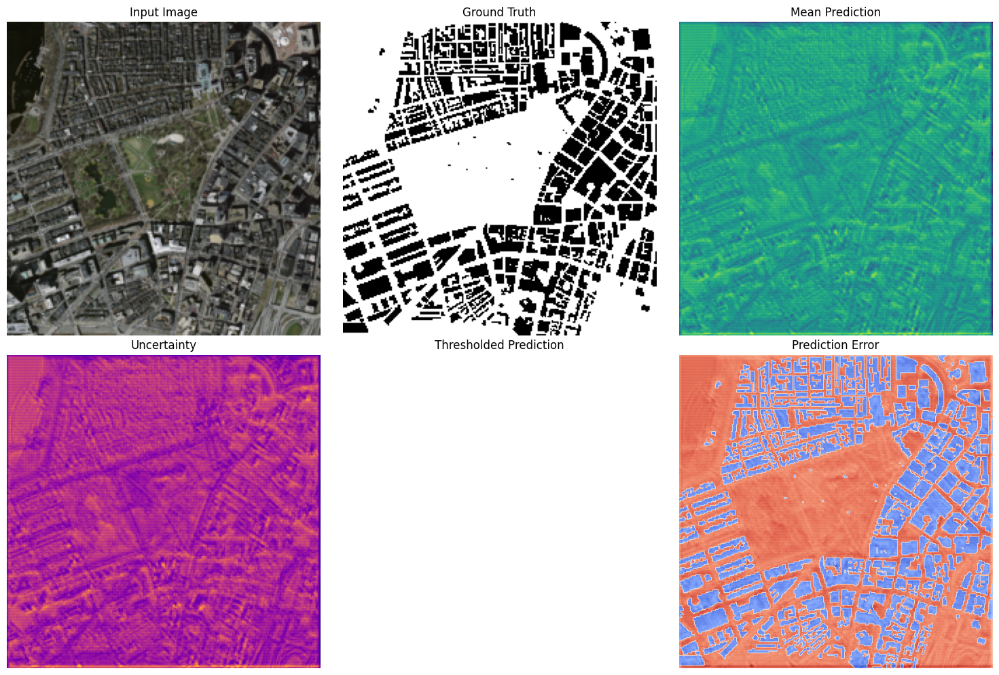


Updated Model Comparison:
Model           IoU        Dice       Pixel Accuracy  Precision  Recall     F1 Score   Mean IoU  
----------------------------------------------------------------------------------------------------
Bayesian UNet   0.1860     0.3137     18.60           0.1860     1.0000     0.3137     0.1860    


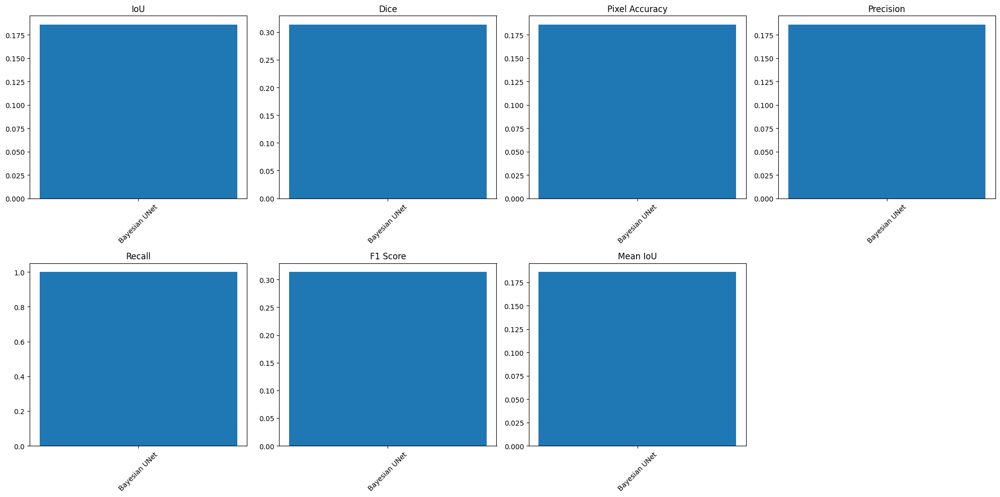

In [28]:
import torch
import torch.nn as nn
import torchvision.transforms as transforms
from torch.utils.data import DataLoader
from torchvision.models.segmentation import deeplabv3_resnet101
import numpy as np
import matplotlib.pyplot as plt
from sklearn.metrics import precision_score, recall_score, f1_score

class BayesianUNet(nn.Module):
    def __init__(self, dropout_rate=0.5):
        super(BayesianUNet, self).__init__()
        self.model = UNet(n_channels=3, n_classes=1)
        self.dropout = nn.Dropout2d(p=dropout_rate)

    def forward(self, x):
        x = self.model(x)
        x = self.dropout(x)
        return x

# Model setup
bayesian_model = BayesianUNet(dropout_rate=0.5)
bayesian_model = bayesian_model.to(device)

# Loss function and optimizer
criterion = nn.BCEWithLogitsLoss()
optimizer = torch.optim.Adam(bayesian_model.parameters(), lr=0.001)

# Learning rate scheduler
scheduler = torch.optim.lr_scheduler.ReduceLROnPlateau(optimizer, mode='min', factor=0.1, patience=5, verbose=True)

# Bayesian prediction function
def bayesian_predict(model, inputs, num_samples=30):
    model.train()  # Enable dropout during inference
    predictions = []
    with torch.no_grad():
        for _ in range(num_samples):
            outputs = model(inputs)
            predictions.append(torch.sigmoid(outputs))
    return torch.stack(predictions)

# Evaluation function with uncertainty
def evaluate_with_uncertainty(model, loader, device, num_samples=30):
    model.eval()
    all_means = []
    all_uncertainties = []
    all_targets = []

    with torch.no_grad():
        for inputs, targets in loader:
            inputs, targets = inputs.to(device), targets.to(device)
            predictions = bayesian_predict(model, inputs, num_samples)
            means = predictions.mean(dim=0)
            uncertainties = predictions.var(dim=0)

            all_means.extend(means.cpu().numpy().flatten())
            all_uncertainties.extend(uncertainties.cpu().numpy().flatten())
            all_targets.extend(targets.cpu().numpy().flatten())

    all_means = np.array(all_means)
    all_uncertainties = np.array(all_uncertainties)
    all_targets = np.array(all_targets)

    # Calculate metrics
    threshold = 0.5
    predictions = (all_means > threshold).astype(int)
    accuracy = np.mean(predictions == all_targets)

    return accuracy, all_means, all_uncertainties, all_targets, predictions

# Evaluate the Bayesian model
accuracy, means, uncertainties, targets, predictions = evaluate_with_uncertainty(bayesian_model, test_loader, device)

print(f"Bayesian Model Accuracy: {accuracy:.4f}")

# Analyze errors with uncertainty
false_positives = ((means > 0.5) & (targets == 0))
false_negatives = ((means <= 0.5) & (targets == 1))

print(f"Average uncertainty: {uncertainties.mean():.4f}")
print(f"Uncertainty in false positives: {uncertainties[false_positives].mean():.4f}")
print(f"Uncertainty in false negatives: {uncertainties[false_negatives].mean():.4f}")

# Visualize predictions with uncertainty
def visualize_predictions_with_uncertainty(inputs, means, uncertainties, targets):
    fig, axs = plt.subplots(2, 3, figsize=(15, 10))

    axs[0, 0].imshow(inputs[0].permute(1, 2, 0).cpu().numpy())
    axs[0, 0].set_title('Input Image')
    axs[0, 0].axis('off')

    axs[0, 1].imshow(targets[0].squeeze().cpu().numpy(), cmap='binary')
    axs[0, 1].set_title('Ground Truth')
    axs[0, 1].axis('off')

    axs[0, 2].imshow(means[0].squeeze().cpu().numpy(), cmap='viridis')
    axs[0, 2].set_title('Mean Prediction')
    axs[0, 2].axis('off')

    axs[1, 0].imshow(uncertainties[0].squeeze().cpu().numpy(), cmap='plasma')
    axs[1, 0].set_title('Uncertainty')
    axs[1, 0].axis('off')

    axs[1, 1].imshow((means[0].squeeze().cpu() > 0.5).float().numpy(), cmap='binary')
    axs[1, 1].set_title('Thresholded Prediction')
    axs[1, 1].axis('off')

    axs[1, 2].imshow(torch.abs(means[0].squeeze() - targets[0].squeeze()).cpu().numpy(), cmap='coolwarm')
    axs[1, 2].set_title('Prediction Error')
    axs[1, 2].axis('off')

    plt.tight_layout()
    plt.show()

# Visualize a sample prediction
sample_inputs, sample_targets = next(iter(test_loader))
sample_inputs, sample_targets = sample_inputs.to(device), sample_targets.to(device)
sample_predictions = bayesian_predict(bayesian_model, sample_inputs)
sample_means = sample_predictions.mean(dim=0)
sample_uncertainties = sample_predictions.var(dim=0)

visualize_predictions_with_uncertainty(sample_inputs, sample_means, sample_uncertainties, sample_targets)

# Initialize all_results if it doesn't exist
if 'all_results' not in locals():
    all_results = []

# Add Bayesian model results to the comparison
bayesian_model_results = {
    'Model': 'Bayesian UNet',
    'IoU': compute_iou(predictions, targets),
    'Dice': compute_dice(predictions, targets),
    'Pixel Accuracy': accuracy,
    'Precision': precision_score(targets, predictions),
    'Recall': recall_score(targets, predictions),
    'F1 Score': f1_score(targets, predictions),
    'Mean IoU': np.mean([compute_iou(pred, target) for pred, target in zip(predictions, targets)])
}

all_results.append(bayesian_model_results)

# Update the comparison table and visualization
print("\nUpdated Model Comparison:")
print("{:<15} {:<10} {:<10} {:<15} {:<10} {:<10} {:<10} {:<10}".format(
    "Model", "IoU", "Dice", "Pixel Accuracy", "Precision", "Recall", "F1 Score", "Mean IoU"))
print("-" * 100)

for result in all_results:
    print("{:<15} {:<10.4f} {:<10.4f} {:<15.2f} {:<10.4f} {:<10.4f} {:<10.4f} {:<10.4f}".format(
        result['Model'], result['IoU'], result['Dice'], result['Pixel Accuracy'] * 100,
        result['Precision'], result['Recall'], result['F1 Score'], result['Mean IoU']))

# Update the visualization
plt.figure(figsize=(20, 10))
metrics = ['IoU', 'Dice', 'Pixel Accuracy', 'Precision', 'Recall', 'F1 Score', 'Mean IoU']

for i, metric in enumerate(metrics):
    plt.subplot(2, 4, i+1)
    values = [result[metric] for result in all_results]
    plt.bar(range(len(all_results)), values)
    plt.title(metric)
    plt.xticks(range(len(all_results)), [result['Model'] for result in all_results], rotation=45)

plt.tight_layout()
plt.show()



Bayesian UNet Model Information:
Number of parameters: 7697345
Dropout rate: 0.5
Average uncertainty: 0.0000


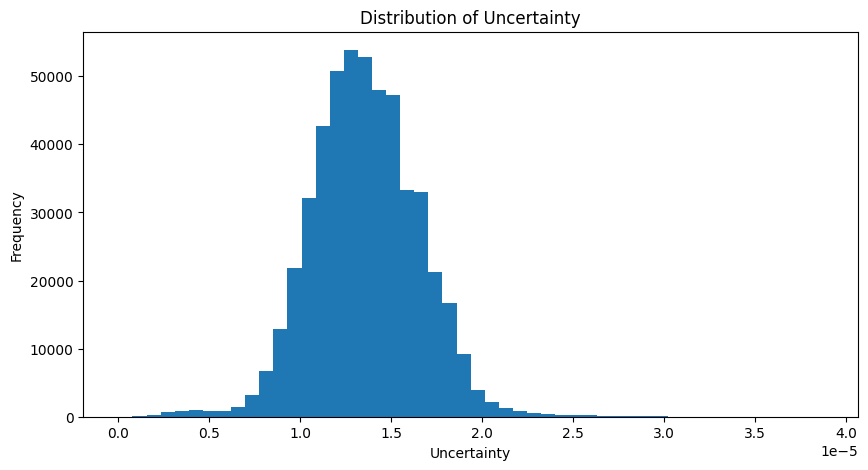

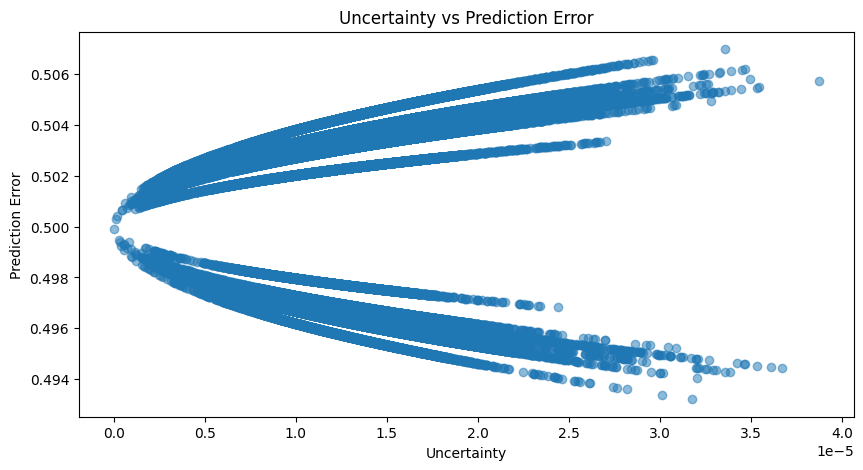


Correlation between uncertainty and prediction error: 0.1378


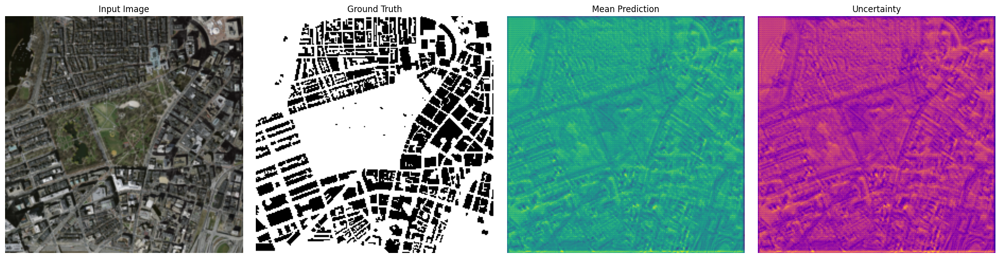

In [30]:

# Print additional information about the Bayesian UNet model
print("\nBayesian UNet Model Information:")
print(f"Number of parameters: {sum(p.numel() for p in bayesian_model.parameters())}")
print(f"Dropout rate: {bayesian_model.dropout.p}")

# Calculate and print the average uncertainty
avg_uncertainty = sample_uncertainties.mean().item()
print(f"Average uncertainty: {avg_uncertainty:.4f}")

# Visualize uncertainty distribution
plt.figure(figsize=(10, 5))
plt.hist(sample_uncertainties.cpu().numpy().flatten(), bins=50)
plt.title("Distribution of Uncertainty")
plt.xlabel("Uncertainty")
plt.ylabel("Frequency")
plt.show()

# Visualize correlation between uncertainty and prediction error
prediction_error = torch.abs(sample_means - sample_targets).cpu().numpy().flatten()
uncertainty = sample_uncertainties.cpu().numpy().flatten()

plt.figure(figsize=(10, 5))
plt.scatter(uncertainty, prediction_error, alpha=0.5)
plt.title("Uncertainty vs Prediction Error")
plt.xlabel("Uncertainty")
plt.ylabel("Prediction Error")
plt.show()

# Print some statistics about the correlation
correlation = np.corrcoef(uncertainty, prediction_error)[0, 1]
print(f"\nCorrelation between uncertainty and prediction error: {correlation:.4f}")

# Visualize a sample prediction with uncertainty
fig, axs = plt.subplots(1, 4, figsize=(20, 5))

axs[0].imshow(sample_inputs[0].permute(1, 2, 0).cpu().numpy())
axs[0].set_title('Input Image')
axs[0].axis('off')

# Fix the shape issue for sample_targets
axs[1].imshow(sample_targets[0].squeeze().cpu().numpy(), cmap='binary')
axs[1].set_title('Ground Truth')
axs[1].axis('off')

axs[2].imshow(sample_means[0].squeeze().cpu().numpy(), cmap='viridis')
axs[2].set_title('Mean Prediction')
axs[2].axis('off')

axs[3].imshow(sample_uncertainties[0].squeeze().cpu().numpy(), cmap='plasma')
axs[3].set_title('Uncertainty')
axs[3].axis('off')

plt.tight_layout()
plt.show()


Epoch [1/5], Loss: 0.5440
Validation Accuracy: 0.5003
Epoch [2/5], Loss: 0.5189
Validation Accuracy: 0.4998
Epoch [3/5], Loss: 0.5120
Validation Accuracy: 0.5010
Epoch [4/5], Loss: 0.5074
Validation Accuracy: 0.5006
Epoch [5/5], Loss: 0.4985
Validation Accuracy: 0.5007
Bayesian Model Accuracy: 0.5001
Average uncertainty: 0.0234
Uncertainty in false positives: 0.0237
Uncertainty in false negatives: 0.0225


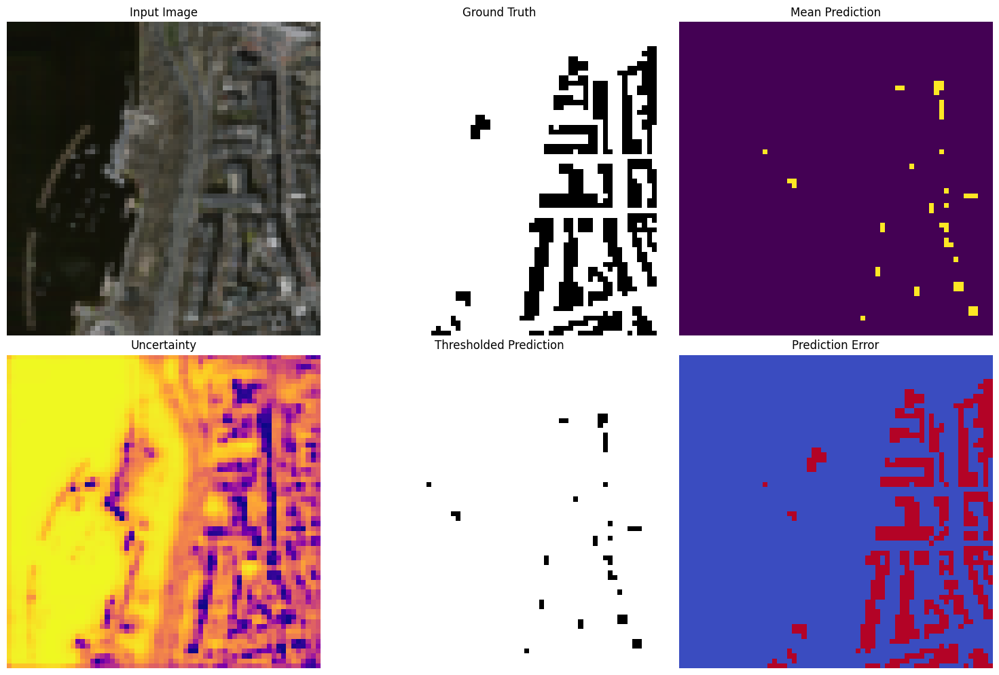


Updated Model Comparison:
Model           IoU        Dice       Pixel Accuracy  Precision  Recall     F1 Score   Mean IoU  
----------------------------------------------------------------------------------------------------
Bayesian UNet   0.1860     0.3137     18.60           0.1860     1.0000     0.3137     0.1860    
Bayesian UNet   0.1869     0.3149     50.01           0.6463     0.5001     0.5395     0.1149    


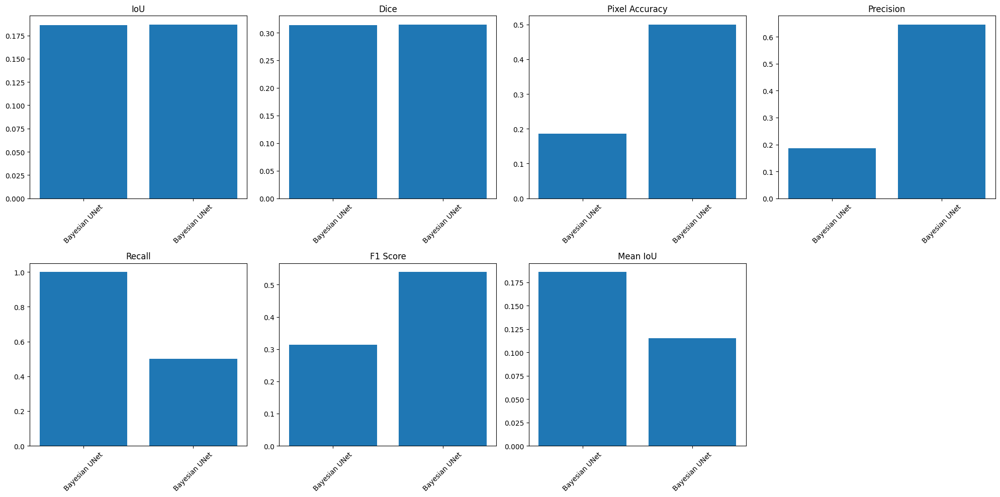

In [71]:

import torch
import torch.nn as nn
import torchvision.transforms as transforms
from torch.utils.data import DataLoader
from torchvision.models.segmentation import deeplabv3_resnet101
import numpy as np
import matplotlib.pyplot as plt
from sklearn.metrics import precision_score, recall_score, f1_score

class BayesianUNet(nn.Module):
    def __init__(self, dropout_rate=0.5):
        super(BayesianUNet, self).__init__()
        self.model = UNet(n_channels=3, n_classes=2).to(device)
        self.dropout = nn.Dropout2d(p=dropout_rate)

    def forward(self, x):
        x = self.model(x)
        x = self.dropout(x)
        return x

# Model setup
bayesian_model = BayesianUNet(dropout_rate=0.5)
bayesian_model = bayesian_model.to(device)

# Loss function and optimizer
criterion = nn.CrossEntropyLoss()
optimizer = torch.optim.Adam(bayesian_model.parameters(), lr=0.001)

# Learning rate scheduler
scheduler = torch.optim.lr_scheduler.ReduceLROnPlateau(optimizer, mode='min', factor=0.1, patience=5, verbose=True)

# Bayesian prediction function
def bayesian_predict(model, inputs, num_samples=30):
    model.train()
    predictions = []
    with torch.no_grad():
        for _ in range(num_samples):
            outputs = model(inputs)
            predictions.append(torch.softmax(outputs, dim=1))
    return torch.stack(predictions)

# Evaluation function with uncertainty
def evaluate_with_uncertainty(model, loader, device, num_samples=30):
    model.eval()
    all_means = []
    all_uncertainties = []
    all_targets = []

    with torch.no_grad():
        for inputs, targets in loader:
            inputs, targets = inputs.to(device), targets.to(device)
            predictions = bayesian_predict(model, inputs, num_samples)
            means = predictions.mean(dim=0)
            uncertainties = predictions.var(dim=0)

            all_means.extend(means.cpu().numpy().reshape(-1, 2))
            all_uncertainties.extend(uncertainties.cpu().numpy().reshape(-1, 2))
            all_targets.extend(targets.cpu().numpy().flatten())

    all_means = np.array(all_means)
    all_uncertainties = np.array(all_uncertainties)
    all_targets = np.array(all_targets)

    predictions = np.argmax(all_means, axis=1)

    accuracy = np.mean(predictions == all_targets)

    return accuracy, all_means, all_uncertainties, all_targets, predictions

# Training loop
num_epochs = 5
for epoch in range(num_epochs):
    bayesian_model.train()
    epoch_loss = 0.0
    for inputs, targets in patch_train_loader:
        inputs, targets = inputs.to(device), targets.to(device)
        optimizer.zero_grad()
        outputs = bayesian_model(inputs)
        loss = criterion(outputs, targets.squeeze(1).long())
        loss.backward()
        optimizer.step()
        epoch_loss += loss.item()

    avg_loss = epoch_loss / len(patch_train_loader)
    print(f"Epoch [{epoch+1}/{num_epochs}], Loss: {avg_loss:.4f}")

    bayesian_model.eval()
    val_accuracy, _, _, _, _ = evaluate_with_uncertainty(bayesian_model, patch_val_loader, device)
    print(f"Validation Accuracy: {val_accuracy:.4f}")

    scheduler.step(avg_loss)

# Evaluate the Bayesian model
accuracy, means, uncertainties, targets, predictions = evaluate_with_uncertainty(bayesian_model, patch_test_loader, device)

print(f"Bayesian Model Accuracy: {accuracy:.4f}")

# Analyze errors with uncertainty
false_positives = ((predictions == 1) & (targets == 0))
false_negatives = ((predictions == 0) & (targets == 1))

print(f"Average uncertainty: {uncertainties.mean():.4f}")
print(f"Uncertainty in false positives: {uncertainties[false_positives].mean():.4f}")
print(f"Uncertainty in false negatives: {uncertainties[false_negatives].mean():.4f}")

# Visualize predictions with uncertainty
def visualize_predictions_with_uncertainty(inputs, means, uncertainties, targets):
    fig, axs = plt.subplots(2, 3, figsize=(15, 10))

    axs[0, 0].imshow(inputs[0].cpu().permute(1, 2, 0).numpy())
    axs[0, 0].set_title('Input Image')
    axs[0, 0].axis('off')

    axs[0, 1].imshow(targets[0].cpu().squeeze().numpy(), cmap='binary')
    axs[0, 1].set_title('Ground Truth')
    axs[0, 1].axis('off')

    axs[0, 2].imshow(np.argmax(means[0].cpu().numpy(), axis=0), cmap='viridis')
    axs[0, 2].set_title('Mean Prediction')
    axs[0, 2].axis('off')

    axs[1, 0].imshow(uncertainties[0].cpu().mean(axis=0).numpy(), cmap='plasma')
    axs[1, 0].set_title('Uncertainty')
    axs[1, 0].axis('off')

    axs[1, 1].imshow(np.argmax(means[0].cpu().numpy(), axis=0), cmap='binary')
    axs[1, 1].set_title('Thresholded Prediction')
    axs[1, 1].axis('off')

    axs[1, 2].imshow(np.abs(np.argmax(means[0].cpu().numpy(), axis=0) - targets[0].cpu().squeeze().numpy()), cmap='coolwarm')
    axs[1, 2].set_title('Prediction Error')
    axs[1, 2].axis('off')

    plt.tight_layout()
    plt.show()

# Visualize a sample prediction
sample_inputs, sample_targets = next(iter(patch_test_loader))
sample_inputs, sample_targets = sample_inputs.to(device), sample_targets.to(device)
sample_predictions = bayesian_predict(bayesian_model, sample_inputs)
sample_means = sample_predictions.mean(dim=0)
sample_uncertainties = sample_predictions.var(dim=0)

visualize_predictions_with_uncertainty(sample_inputs, sample_means, sample_uncertainties, sample_targets)

# Add Bayesian model results to the comparison
bayesian_model_results = {
    'Model': 'Bayesian UNet',
    'IoU': compute_iou(predictions, targets),
    'Dice': compute_dice(predictions, targets),
    'Pixel Accuracy': accuracy,
    'Precision': precision_score(targets, predictions, average='weighted'),
    'Recall': recall_score(targets, predictions, average='weighted'),
    'F1 Score': f1_score(targets, predictions, average='weighted'),
    'Mean IoU': np.mean([compute_iou(pred, target) for pred, target in zip(predictions, targets)])
}

all_results.append(bayesian_model_results)

# Update the comparison table and visualization
print("\nUpdated Model Comparison:")
print("{:<15} {:<10} {:<10} {:<15} {:<10} {:<10} {:<10} {:<10}".format(
    "Model", "IoU", "Dice", "Pixel Accuracy", "Precision", "Recall", "F1 Score", "Mean IoU"))
print("-" * 100)

for result in all_results:
    print("{:<15} {:<10.4f} {:<10.4f} {:<15.2f} {:<10.4f} {:<10.4f} {:<10.4f} {:<10.4f}".format(
        result['Model'], result['IoU'], result['Dice'], result['Pixel Accuracy'] * 100,
        result['Precision'], result['Recall'], result['F1 Score'], result['Mean IoU']))

# Update the visualization
plt.figure(figsize=(20, 10))
metrics = ['IoU', 'Dice', 'Pixel Accuracy', 'Precision', 'Recall', 'F1 Score', 'Mean IoU']

for i, metric in enumerate(metrics):
    plt.subplot(2, 4, i+1)
    values = [result[metric] for result in all_results]
    plt.bar(range(len(all_results)), values)
    plt.title(metric)
    plt.xticks(range(len(all_results)), [result['Model'] for result in all_results], rotation=45)

plt.tight_layout()
plt.show()
